# Denoising: Traditional Methods

In [4]:
# Used in BRAINS
channels_32 = ["FP1", "AF3", "F3", "FC1", "C3", "FC3", "T7", "CP5",
               "CPP1h", "P1", "P7", "P9", "PO3", "O1", "OI1h", "POz", 
               "Oz", "OI2h", "O2", "PO4", "P10", "P8", "P2", "CPP2h",
               "CP6", "T8", "FC4", "C4", "FC2", "F4", "AF4", "FP2"]

print(len(channels_32))

32


## Data Preview (Before Denoising)

### Load Data (Batch from File)

In [ ]:
import numpy as np
import pandas as pd
from keras.utils import to_categorical

def batch_generator ( df, 
                      n, 
                      start_idx, 
                      start_timestep,
                      end_timestep,
                      selected_channels,
                      batch_size,
                      stats_loc ):
    
    # Modified from: https://medium.com/analytics-vidhya/train-keras-model-with-large-dataset-batch-training-6b3099fdf366
    idx = 1
    steps = int(np.ceil(n / (batch_size // 2)))
    
    while True:
        start_row = start_idx + (idx-1) * batch_size
        skip = list(range(1, start_row + 1))
        
        print(f"Yielding batch idx={idx}, skiprows={start_row}", flush=True)
        yield load_data( df, 
                         skip, 
                         start_timestep,
                         end_timestep, 
                         selected_channels,
                         batch_size,
                         stats_loc )
        if idx < steps:
            idx += 1
        else:
            idx = 1

In [ ]:
def load_data ( df, 
                skip, 
                start_timestep,
                end_timestep, 
                selected_channels,
                batch_size,
                stats_loc ):
    
    # Modified from: https://medium.com/analytics-vidhya/train-keras-model-with-large-dataset-batch-training-6b3099fdf366
    df = pd.read_csv (
                  df, 
                  skiprows = skip,
                  nrows    = batch_size )
    n_channels = len(selected_channels)
    n_timesteps = (end_timestep - start_timestep) + 1

    # Remove Data with Label -1
    data = df[df['label'] != -1]

    # Take Selected Channels and Timesteps' Columns
    selected_columns = [col for col in data.columns
                        if any(col.startswith(ch + '_') \
                               and start_timestep <= int(col.split('_')[-1]) <= end_timestep
                               for ch in selected_channels)
                        or col == 'label']
    data = data[selected_columns].astype(np.float32)

    
    # NORMALIZATION
    if (stats_loc != ''):
        stats_df = pd.read_csv(stats_loc)
        for idx, ch_name in enumerate(selected_channels):
            ch_mean = stats_df.loc[stats_df['channel'] == ch_name, 'mean'].values[0]
            ch_std = stats_df.loc[stats_df['channel'] == ch_name, 'std'].values[0]
            
            start_col = idx * n_timesteps
            end_col = (idx + 1) * n_timesteps
        
            data.iloc[:, start_col:end_col] = \
                (data.iloc[:, start_col:end_col] - ch_mean) / ch_std

    
    # INTEGRATION AND RESHAPE
    data_array = data.iloc[:, :-1].values \
                                  .reshape((-1, n_channels, n_timesteps)) \
                                  .astype(np.float32)
    labels = data['label'].values

    
    return (data_array, to_categorical(labels, num_classes=10).astype('float32'))

In [ ]:
data_generator     = batch_generator (
    df                = '/kaggle/input/raw-eeg-2b/X_raw_train2B.csv',
    n                 = 30000,
    start_idx         = 0,
    start_timestep    = 0,
    end_timestep      = 499,
    selected_channels = channels_32,
    batch_size        = 2*500,
    stats_loc         = ''
)

In [ ]:
X_batch = []
y_batch = []

for _ in range(20):
    X, y = next(data_generator)
    X_batch.append(X)
    y_batch.append(y)

In [ ]:
X_batch = np.array(X_batch)
y_batch = np.array(y_batch)

X = X_batch.reshape(10000, 32, 500)
y = y_batch.reshape(10000, 10) 

In [ ]:
print(X.shape)
print(y.shape)

### Load Data (Batch from Hugging Face)

In [19]:
from datasets import load_dataset
from itertools import islice
import pandas as pd
import numpy as np
from keras.utils import to_categorical

dataset = load_dataset("DavidVivancos/MindBigData2023_MNIST-2B", split="train", streaming=True)
batch_iterator = iter(dataset)

In [20]:
X_batch = []
y_batch = []

n_channels = 32
n_timesteps = 256

batch_size = 3000
for i in range(20):
    print(f"Retrieving batch {i}...", flush=True)
    batch = list(islice(batch_iterator, batch_size))
    batch = pd.DataFrame(batch)

    # Remove Data with Label -1
    data = batch[batch['label'] != -1]

    # Take Selected Channels and Timesteps' Columns
    selected_columns = [col for col in data.columns
                        if any(col.startswith(ch + '_') \
                               and 0 <= int(col.split('_')[-1]) <= 255
                               for ch in channels_32)
                        or col == 'label']
    data = data[selected_columns]

    # INTEGRATION AND RESHAPE
    data_array = data.iloc[:, :-1].values \
                                  .reshape((-1, n_channels, n_timesteps)) \
                                  .astype(np.float32)
    labels = data['label'].values

    X_batch.append(data_array)
    y_batch.append(to_categorical(labels, num_classes=10).astype('float32'))\

X = np.concatenate(X_batch, axis=0)
y = np.concatenate(y_batch, axis=0)

Retrieving batch 0...
Retrieving batch 1...
Retrieving batch 2...
Retrieving batch 3...
Retrieving batch 4...
Retrieving batch 5...
Retrieving batch 6...
Retrieving batch 7...
Retrieving batch 8...
Retrieving batch 9...
Retrieving batch 10...
Retrieving batch 11...
Retrieving batch 12...
Retrieving batch 13...
Retrieving batch 14...
Retrieving batch 15...
Retrieving batch 16...
Retrieving batch 17...
Retrieving batch 18...
Retrieving batch 19...


In [21]:
print(X.shape)
print(y.shape)

(30000, 32, 256)
(30000, 10)


### Metrics Function

In [3]:
import numpy as np
from collections import defaultdict
from scipy.spatial.distance import cosine, euclidean

In [2]:
def calculate_metrics(latent_vectors, labels):
    cosine_results = cosine_stats(latent_vectors, labels)
    euclidean_results = euclidean_stats(latent_vectors, labels)
    combined_results = {}
    for label in set(list(cosine_results.keys()) + list(euclidean_results.keys())):
        combined_results[label] = {
            **cosine_results.get(label, {}),
            **euclidean_results.get(label, {})
        }
    return combined_results


def print_metrics(metrics_dict):
    print("\n\n=================================================== METRICS  SUMMARY ===================================================")
    headers = ["Label", "Theta Min", "Theta Max", "Theta Avg", "Euclidean Min", "Euclidean Max", "Euclidean Avg"]
    print(f"{headers[0]:<10} | {headers[1]:<15} | {headers[2]:<15} | {headers[3]:<15} | {headers[4]:<15} | {headers[5]:<15} | {headers[6]:<15}")
    print("-" * 120)

    for label, metrics in metrics_dict.items():
        theta_min = metrics['min_theta']
        theta_max = metrics['max_theta']
        theta_avg = metrics['avg_theta']
        euclidean_min = metrics['min_euclidean']
        euclidean_max = metrics['max_euclidean']
        euclidean_avg = metrics['avg_euclidean']

        print(f"{label:<10} | {theta_min:<15.6f} | {theta_max:<15.6f} | {theta_avg:<15.6f} | {euclidean_min:<15.6f} | {euclidean_max:<15.6f} | {euclidean_avg:<15.6f}")

    print("-" * 120)

#### Euclidean Distance

In [4]:
def euclidean_stats(latent_vectors, labels):
    class_stats = defaultdict(dict)
    unique_labels = np.unique(labels)

    for label in unique_labels:
        # Filter latent vectors for current class
        class_vectors = latent_vectors[labels == label]
        num_vectors = class_vectors.shape[0]

        distances = []
        for i in range(num_vectors):
            for j in range(i + 1, num_vectors):
                dist = euclidean(class_vectors[i], class_vectors[j])
                distances.append(dist)

        class_stats[label]['min_euclidean'] = np.min(distances)
        class_stats[label]['max_euclidean'] = np.max(distances)
        class_stats[label]['avg_euclidean'] = np.mean(distances)

    return class_stats

#### Cosine Similarity

In [5]:
def theta_difference(v1, v2):
    # Cosine similarity
    cos_theta = np.dot(v1, v2) / (np.linalg.norm(v1) * np.linalg.norm(v2))
    cos_theta = np.clip(cos_theta, -1.0, 1.0)
    theta = np.arccos(cos_theta) * (180 / np.pi)
    return theta


def cosine_stats(latent_vectors, labels):
    class_stats = defaultdict(dict)
    unique_labels = np.unique(labels)

    for label in unique_labels:
        # Filter latent vectors for current class
        class_vectors = latent_vectors[labels == label]
        num_vectors = class_vectors.shape[0]

        differences = []
        for i in range(num_vectors):
            for j in range(i + 1, num_vectors):
                theta = theta_difference(class_vectors[i], class_vectors[j])
                differences.append(theta)

        class_stats[label]['min_theta'] = np.min(differences)
        class_stats[label]['max_theta'] = np.max(differences)
        class_stats[label]['avg_theta'] = np.mean(differences)

    return class_stats

### Compute Metrics

In [73]:
labels = np.argmax(y, axis=1)
print_metrics(calculate_metrics(X.reshape(X.shape[0], -1), labels))



=================================================== METRICS  SUMMARY ===================================================
Label      | Theta Min       | Theta Max       | Theta Avg       | Euclidean Min   | Euclidean Max   | Euclidean Avg  
------------------------------------------------------------------------------------------------------------------------
0          | 17.832218       | 162.246482      | 89.731269       | 1015335.187500  | 12669506.000000 | 2389686.790793 
1          | 14.887659       | 164.287077      | 89.753301       | 1022017.500000  | 14942140.000000 | 2398177.508802 
2          | 16.739564       | 161.646810      | 89.719131       | 1047706.812500  | 12368639.000000 | 2439234.756761 
3          | 19.151595       | 161.726662      | 89.741342       | 1012849.125000  | 13745735.000000 | 2455008.352518 
4          | 20.757887       | 157.215037      | 89.684160       | 1020424.250000  | 11943358.000000 | 2398185.473721 
5          | 16.585695       | 161.944509 

### Visualization

In [2]:
import matplotlib.pyplot as plt

def show_sample_per_label_per_channel(ch_num, ch_name, X_batch, y_labels, num=100):
    for cls in range(10):
        plt.figure(figsize=(16, 8))
        for i in range(num):
            idx = np.where(y_labels == cls)[0][i]
            plt.plot(X_batch[idx, ch_num, :], label=f"Sample {i+1}")
            
        plt.title(f"Samples from Label {cls} (Channel {ch_name})")
        plt.xlabel("Timestep")
        plt.ylabel("Amplitude")
        plt.legend(loc='upper right')
        plt.show()

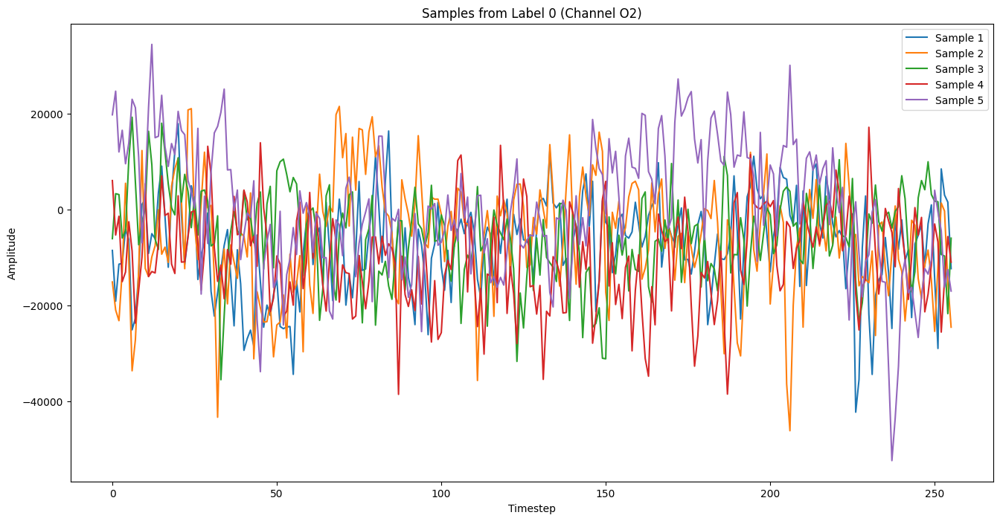

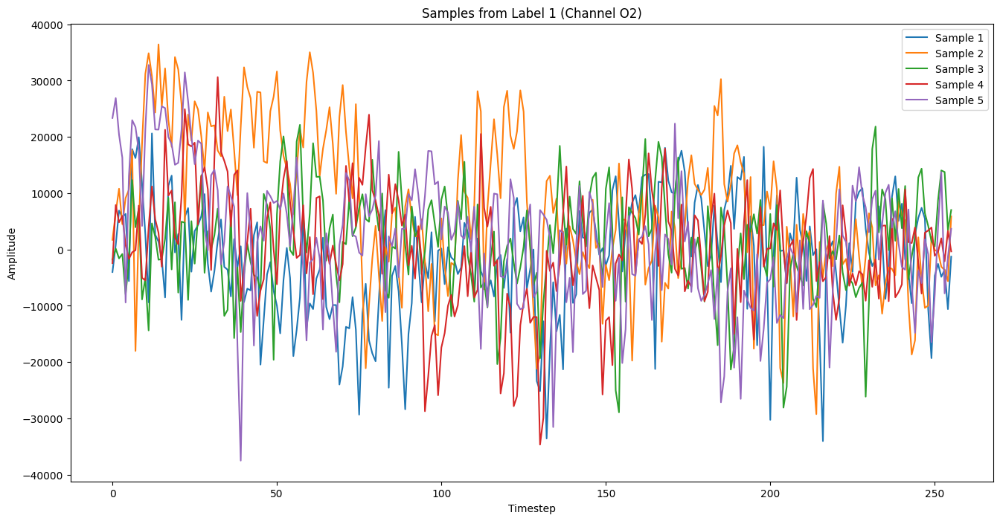

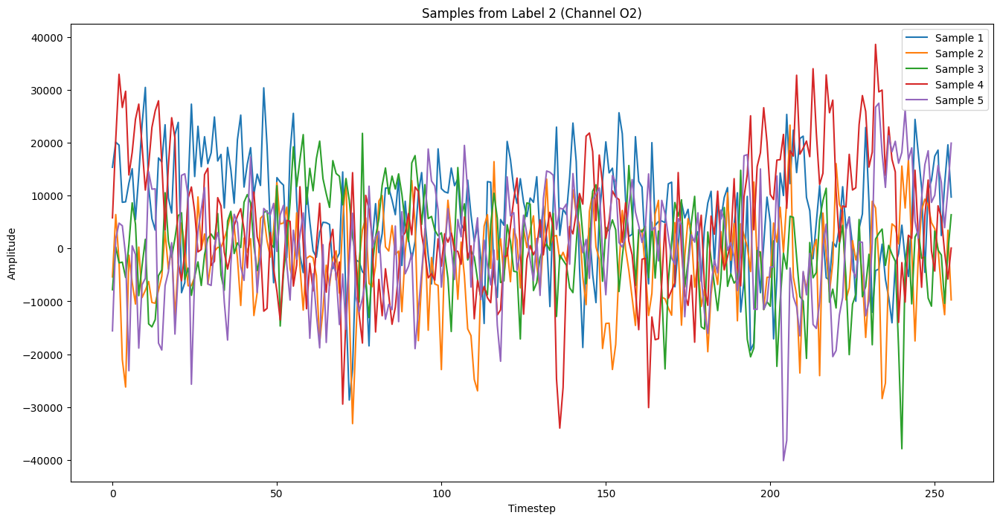

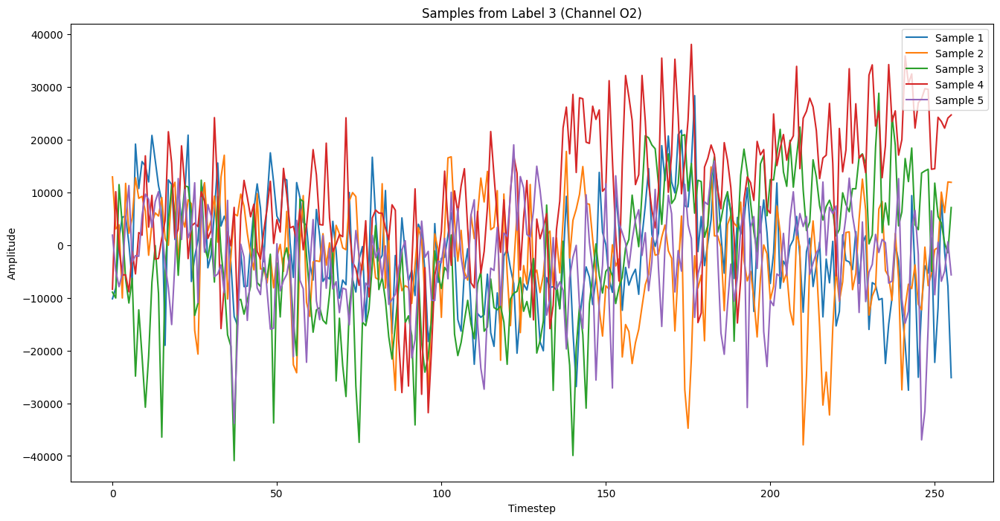

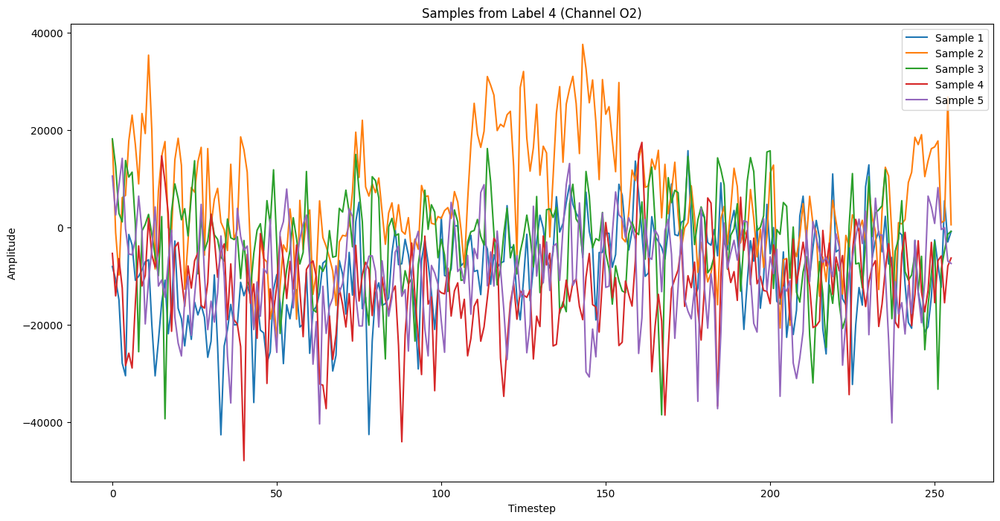

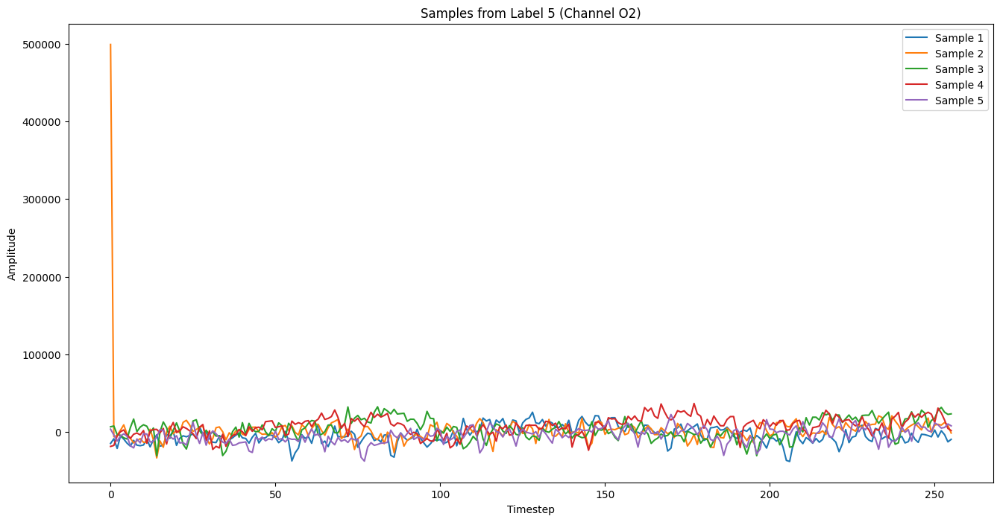

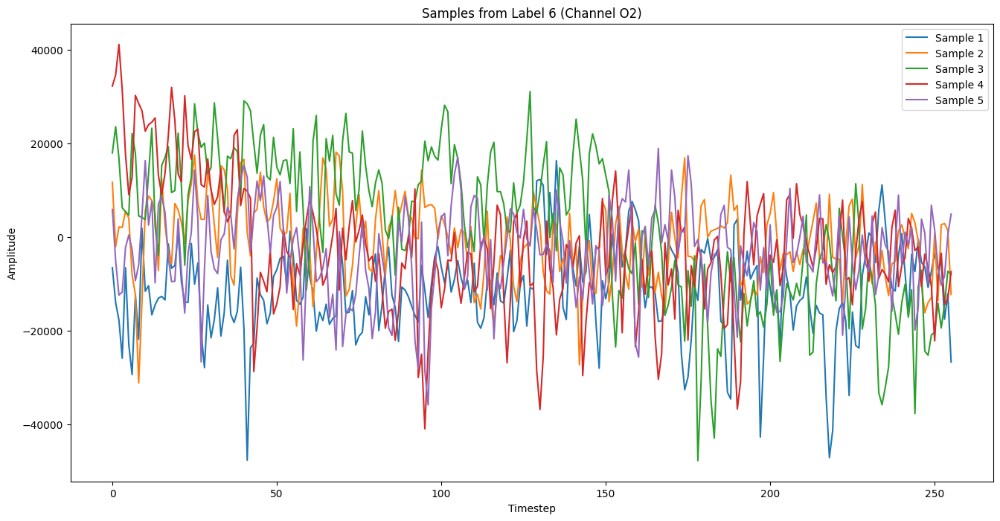

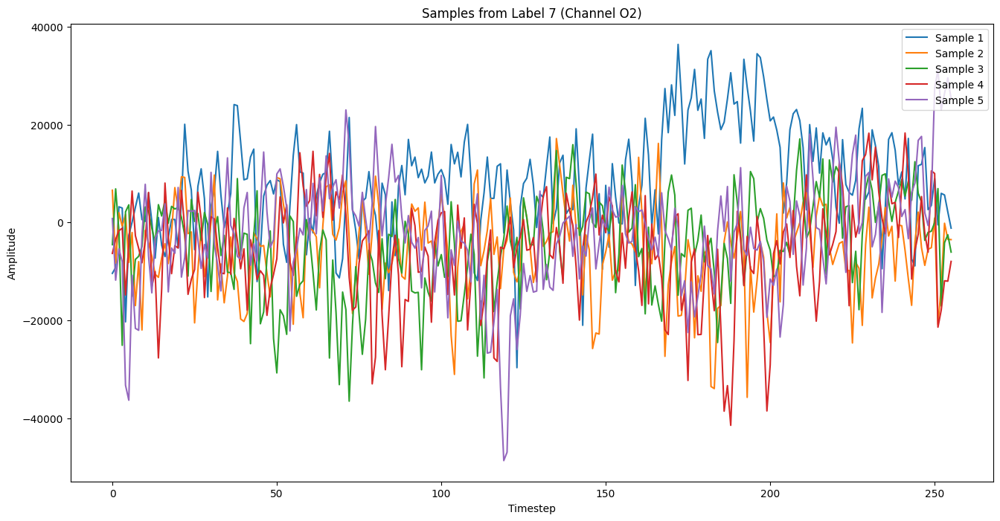

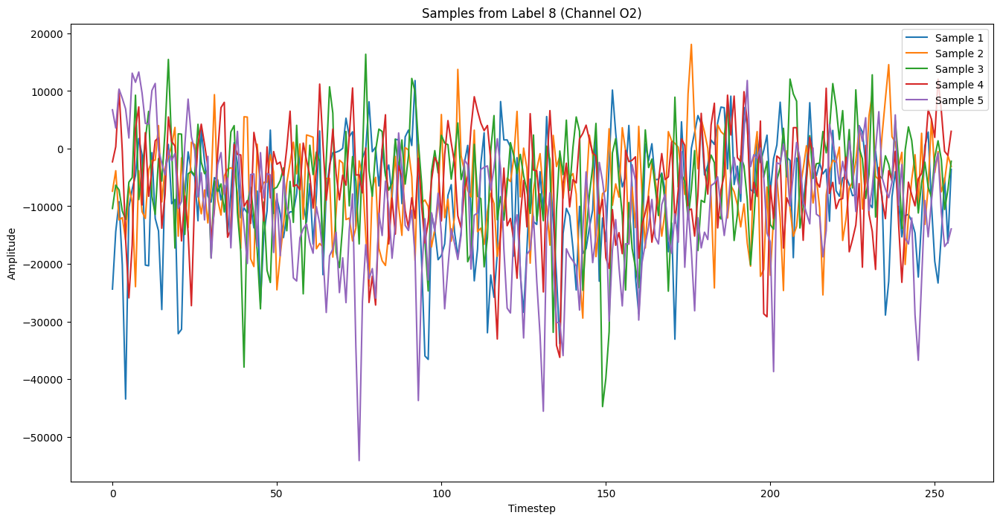

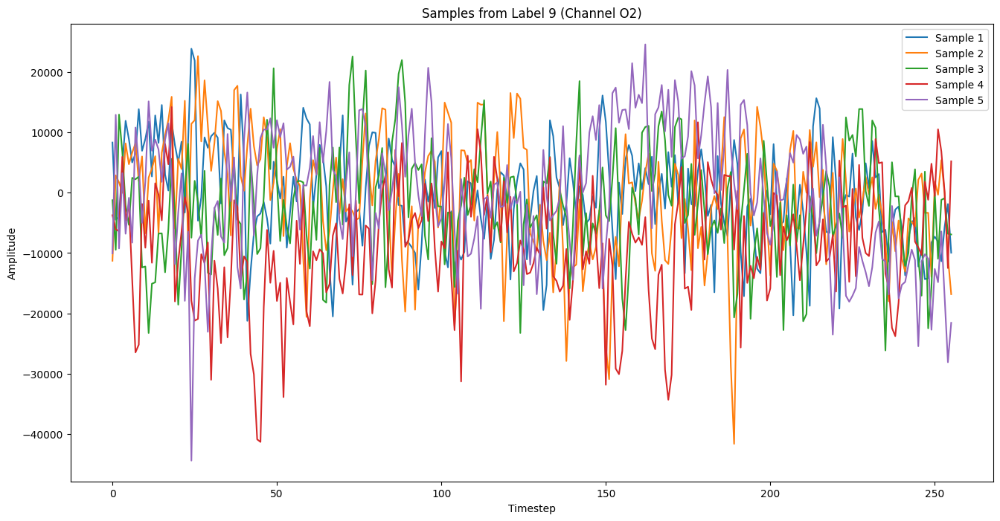

In [5]:
# for i in range(len(channels_32)):
#     show_sample_per_label_per_channel(i, channels_32[i], X, labels, 10)

show_sample_per_label_per_channel(18, channels_32[18], X, labels, 5)

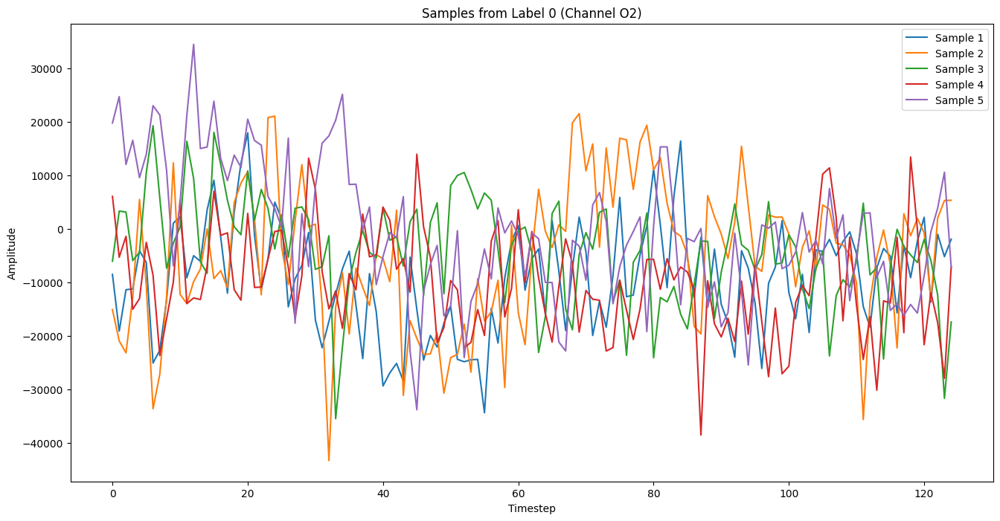

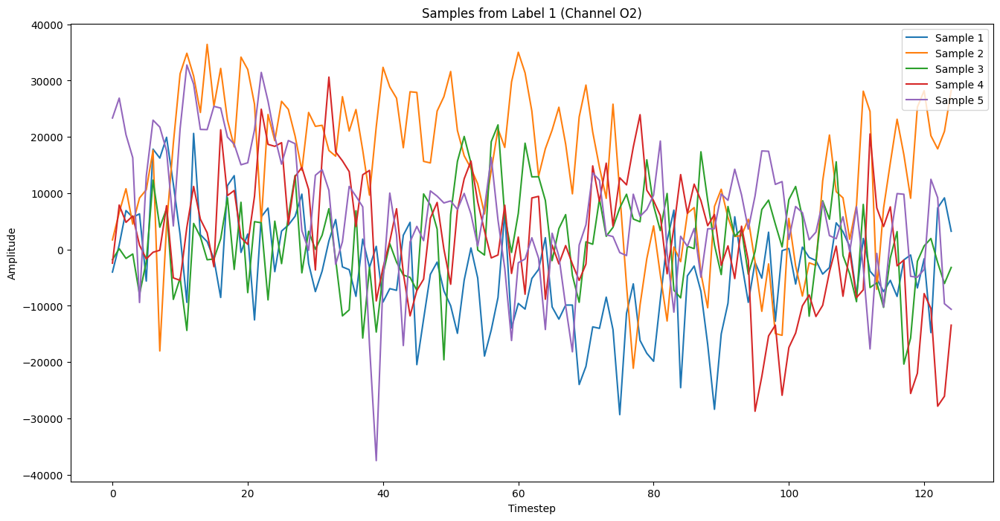

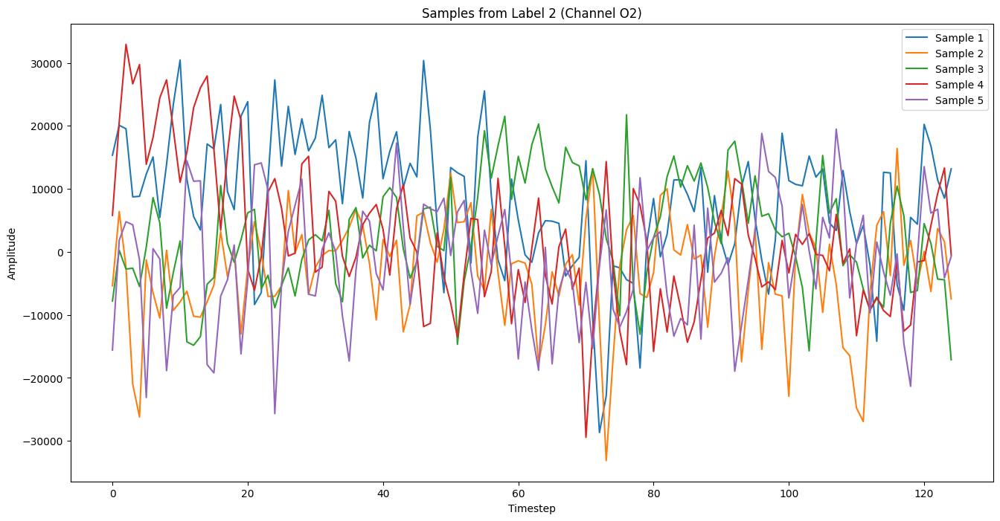

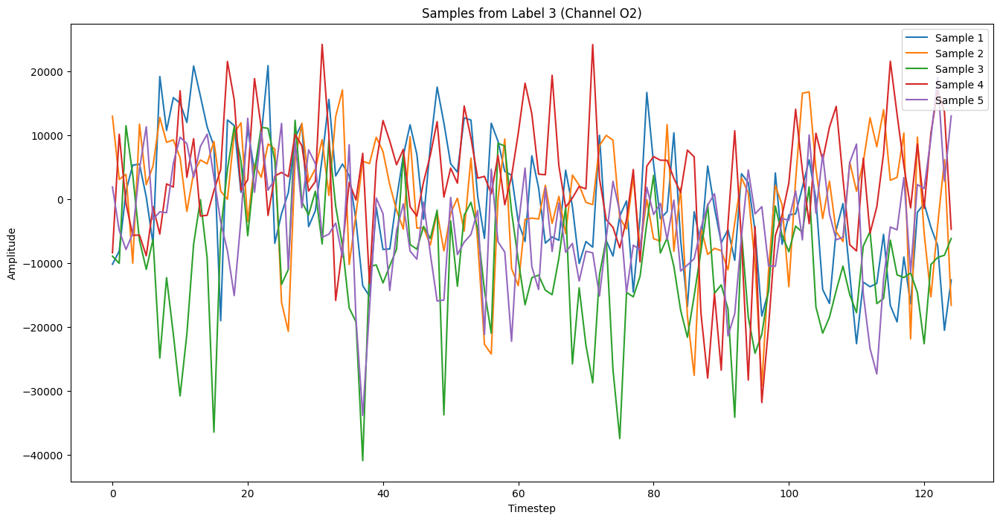

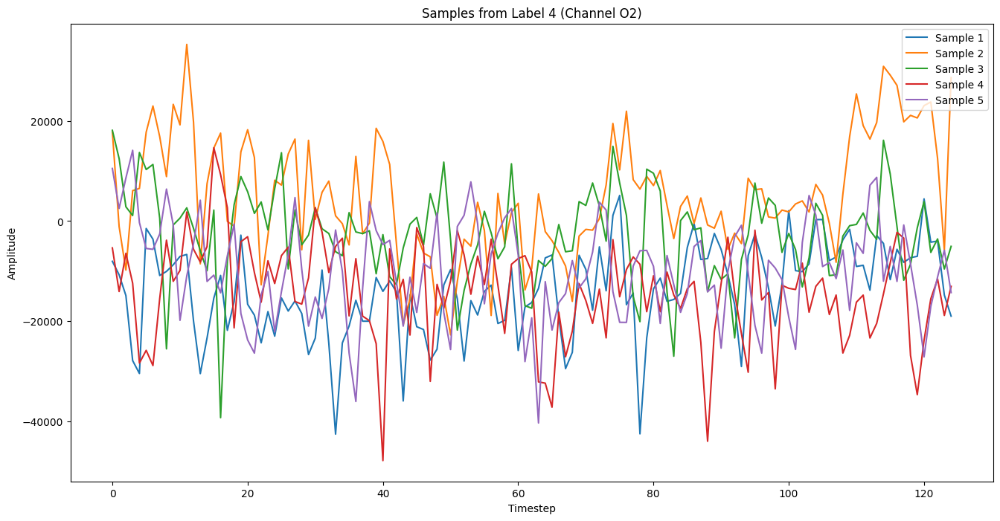

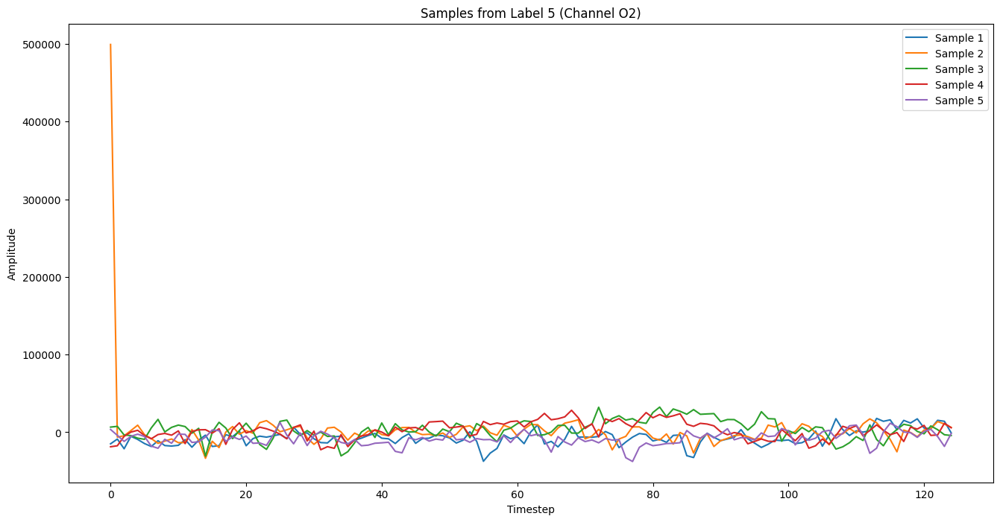

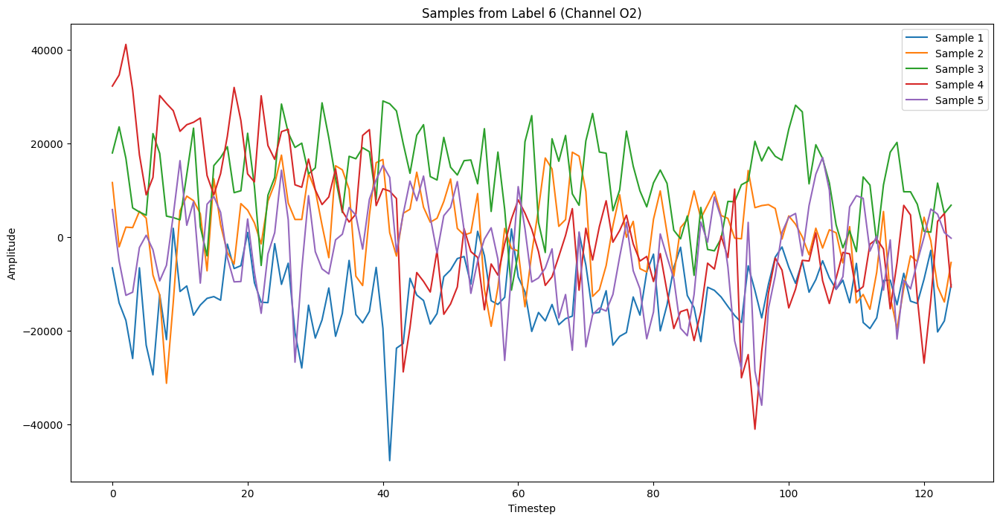

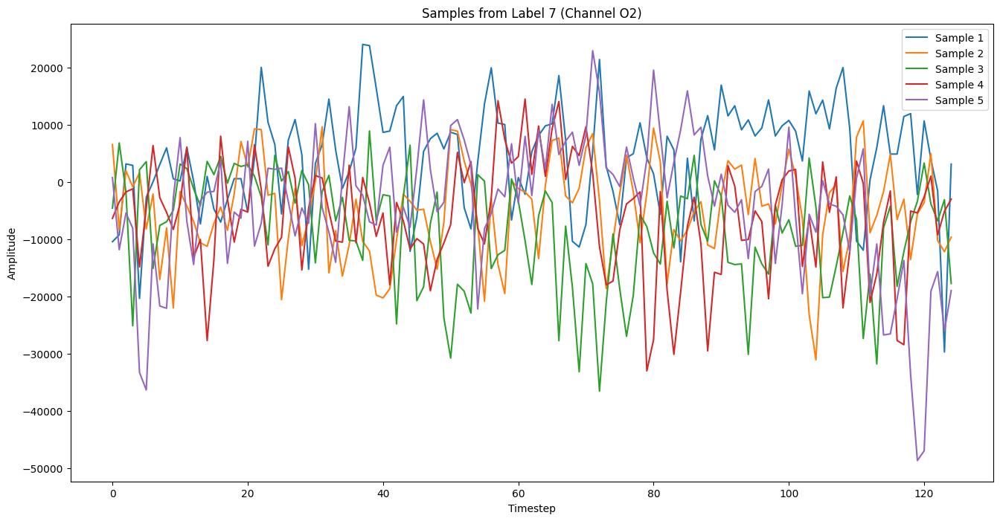

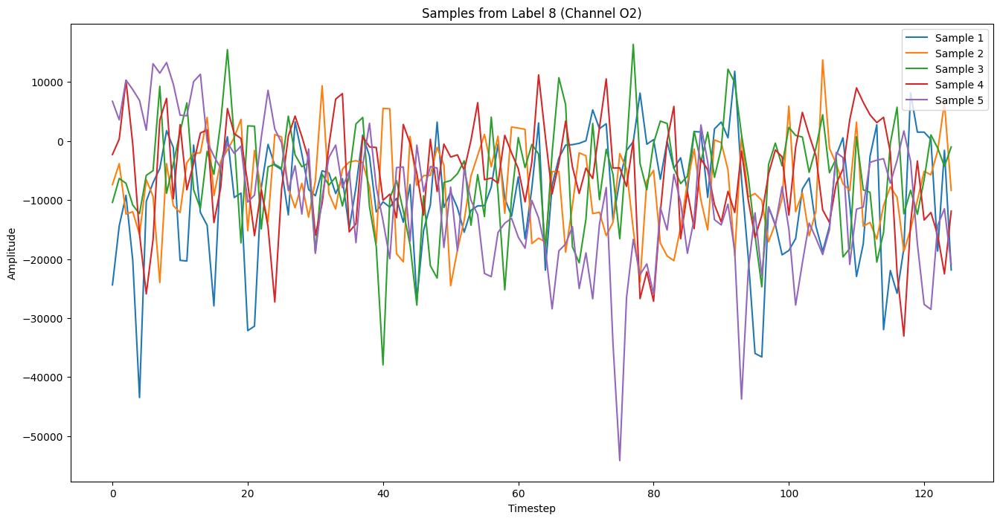

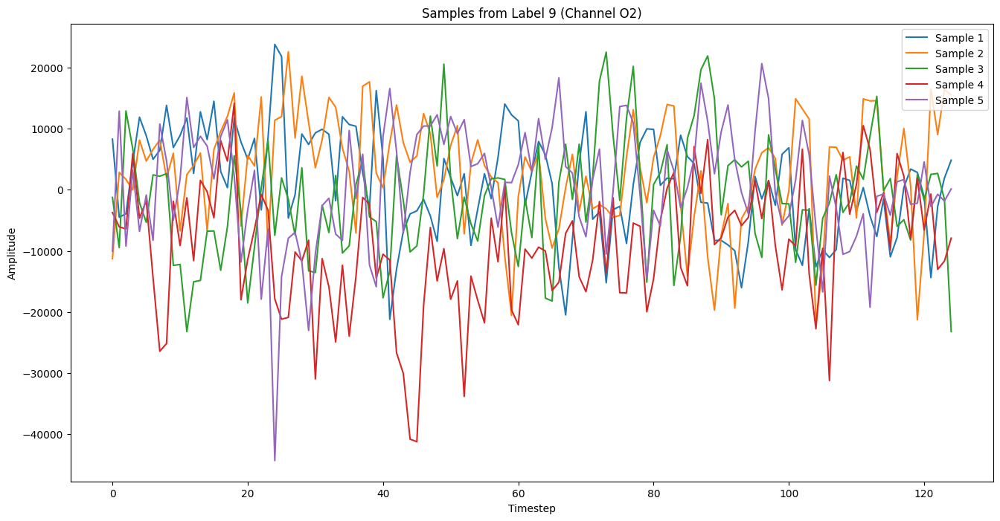

In [6]:
show_sample_per_label_per_channel(18, channels_32[18], X[:, :, :125], labels, 5)

#### t-SNE

In [54]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

def visualize_tSNE(perplexity, lr, X_batch, labels, title, xlim, ylim):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    tsne = TSNE ( 
        n_components  = 2,
        perplexity    = perplexity,
        learning_rate = lr,
        n_iter        = 1000,
        random_state  = 42,
        init          = 'pca',
    )
    embedding = tsne.fit_transform(data_flat)
    
    plt.figure(figsize=(8,6))
    for label in np.unique(labels):
        idxs = labels == label
        plt.scatter(embedding[idxs, 0], embedding[idxs, 1], label=f"Label {label}", alpha=0.6)
    plt.title(f"{title}, perplexity:{perplexity}, learning_rate:{lr}")
    
    if (xlim != '' and ylim != ''):
        plt.xlim(xlim)
        plt.ylim(ylim)
        
    plt.legend()
    plt.grid(True)
    plt.show()

    print(f"Final KL-Divergence: {tsne.kl_divergence_}")
    if (xlim != '' and ylim != ''):
        out_of_x = np.logical_or(embedding[:, 0] < xlim[0], embedding[:, 0] > xlim[1])
        out_of_y = np.logical_or(embedding[:, 1] < ylim[0], embedding[:, 1] > ylim[1])
        out_of_bounds = np.logical_or(out_of_x, out_of_y)
        num_outliers = np.sum(out_of_bounds)
        print(f"Outlier (not shown): {num_outliers}")

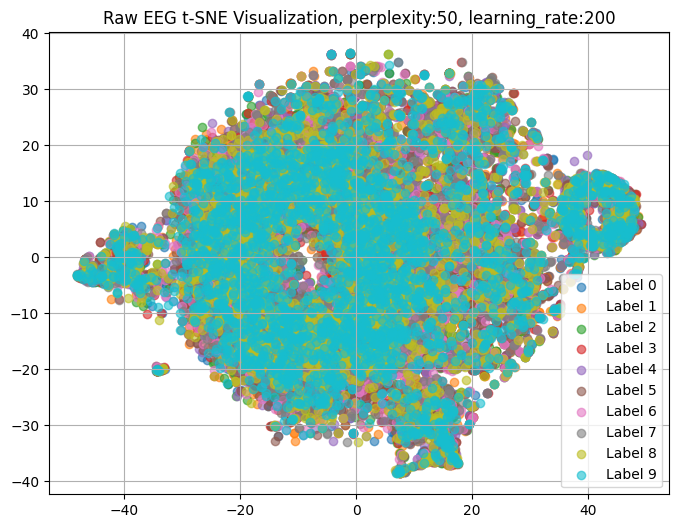

Final KL-Divergence: 3.555048942565918


In [35]:
perplexities = [50]
learning_rates = [200]

for p in perplexities:
    for lr in learning_rates:
        visualize_tSNE(p, lr, X, labels, "Raw EEG t-SNE Visualization", '', '')

In [36]:
from sklearn.manifold import TSNE

def visualize_tSNE_per_label(perplexity, lr, X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    tsne = TSNE ( 
        n_components  = 2,
        perplexity    = perplexity,
        learning_rate = lr,
        n_iter        = 1000,
        random_state  = 42,
        init          = 'pca',
    )
    embedding = tsne.fit_transform(data_flat)

    unique_labels = np.unique(labels)
    num_labels = len(unique_labels)
    cols = 5
    rows = int(np.ceil(num_labels / cols))

    # Compute Scale
    x_min, x_max = embedding[:, 0].min(), embedding[:, 0].max()
    y_min, y_max = embedding[:, 1].min(), embedding[:, 1].max()

    plt.figure(figsize=(4 * cols, 4 * rows))
    for i, label in enumerate(unique_labels):
        idxs = labels == label
        plt.subplot(rows, cols, i + 1)
        plt.scatter(embedding[idxs, 0], embedding[idxs, 1], alpha=0.6, label=f"Label {label}")
        plt.xlim(x_min, x_max)
        plt.ylim(y_min, y_max)
        plt.title(f"Label {label}")
        plt.xticks([])
        plt.yticks([])
        plt.legend()

    plt.suptitle(title, y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

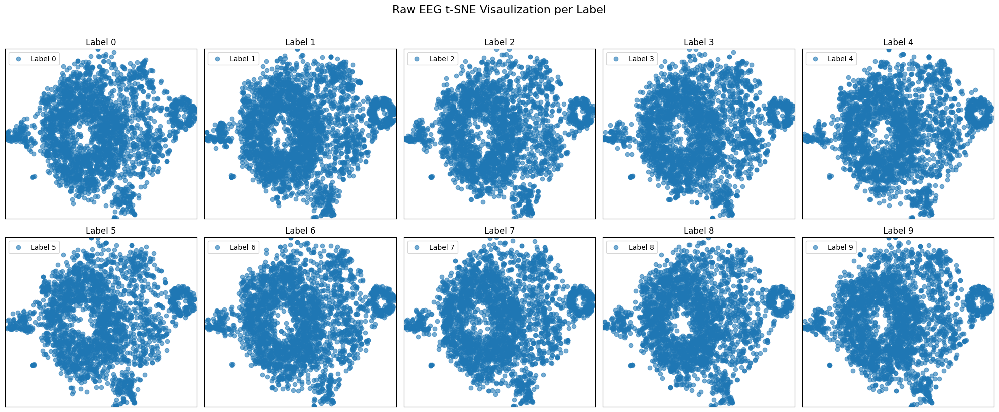

In [37]:
visualize_tSNE_per_label(50, 200, X, labels, "Raw EEG t-SNE Visaulization per Label")

#### UMAP

In [38]:
import umap.umap_ as umap

def visualize_UMAP(X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    reducer = umap.UMAP( 
        n_neighbors  = 30,
        min_dist     = 0.1,
        n_components = 2,
        metric       = 'cosine',
        random_state = 42
    )
    embedding = reducer.fit_transform(data_flat)

    plt.figure(figsize=(10, 8))
    for label in np.unique(labels):
        idx = labels == label
        plt.scatter(embedding[idx, 0], embedding[idx, 1], label=f"Label {label}", alpha=0.6, s=10)
    plt.title(title)
    plt.legend()
    plt.show()

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


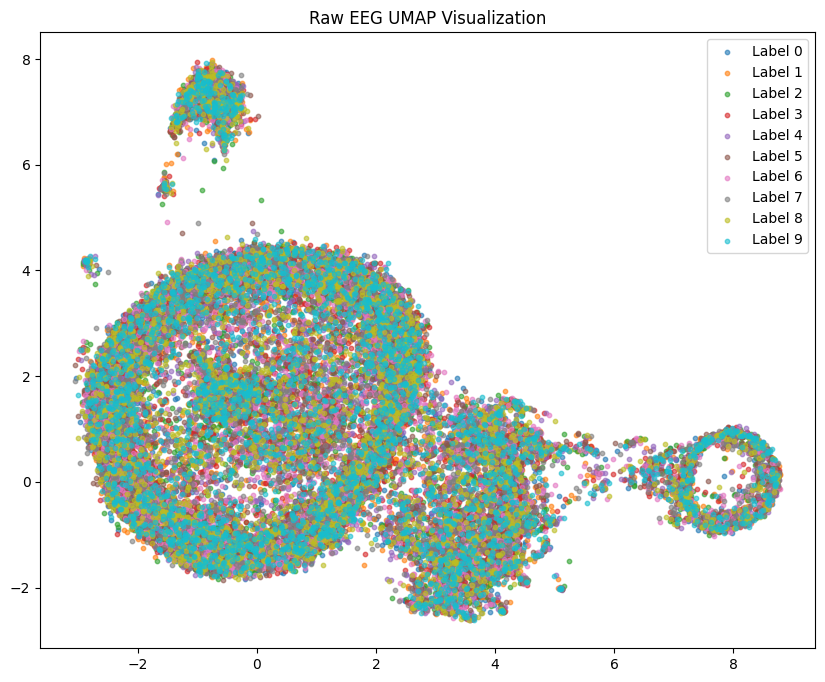

In [39]:
visualize_UMAP(X, labels, "Raw EEG UMAP Visualization")

In [40]:
def visualize_UMAP_per_label(X_batch, labels, title):
    data_flat = X_batch.reshape(X_batch.shape[0], -1)
    
    reducer = umap.UMAP( 
        n_neighbors  = 30,
        min_dist     = 0.1,
        n_components = 2,
        metric       = 'cosine',
        random_state = 42
    )
    embedding = reducer.fit_transform(data_flat)

    # Comnpute Scale
    x_min, x_max = embedding[:, 0].min(), embedding[:, 0].max()
    y_min, y_max = embedding[:, 1].min(), embedding[:, 1].max()

    num_labels = len(np.unique(labels))
    cols = 5
    rows = int(np.ceil(num_labels / cols))

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
    axes = axes.flatten()

    for i, label in enumerate(np.unique(labels)):
        idx = labels == label
        ax = axes[i]
        ax.scatter(embedding[idx, 0], embedding[idx, 1], alpha=0.6, label=f"Label {label}", s=10)
        ax.set_title(f"Label {label}")
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        ax.legend()

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


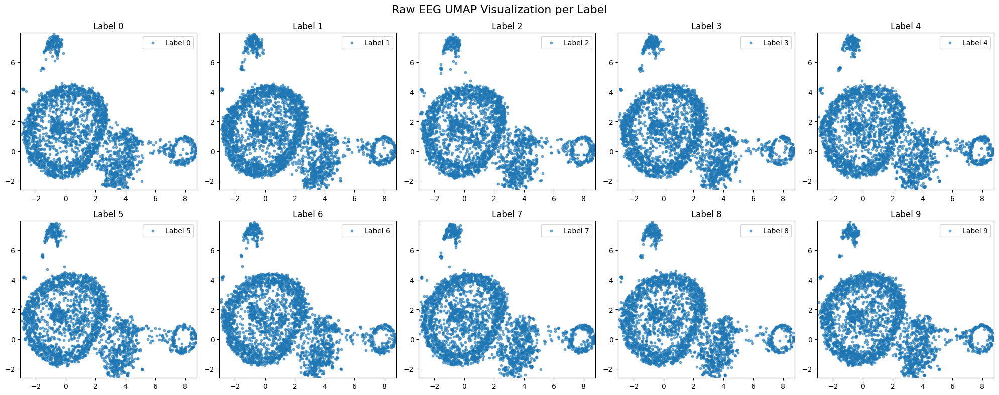

In [41]:
visualize_UMAP_per_label(X, labels, "Raw EEG UMAP Visualization per Label")

### **Signal Analysis (with PyRiemann)**

#### Download Library

In [31]:
!git clone https://github.com/pyRiemann/pyRiemann.git

Cloning into 'pyRiemann'...
remote: Enumerating objects: 4911, done.
remote: Counting objects: 100% (1731/1731), done.
remote: Compressing objects: 100% (631/631), done.
remote: Total 4911 (delta 1473), reused 1101 (delta 1100), pack-reused 3180 (from 3)
Receiving objects: 100% (4911/4911), 1.81 MiB | 6.32 MiB/s, done.
Resolving deltas: 100% (3476/3476), done.


In [32]:
cd "pyRiemann"

/kaggle/working/pyRiemann


In [33]:
!pip install .

Processing /kaggle/working/pyRiemann
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.1/62.1 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.9/16.9 MB 38.6 MB/s eta 0:00:00:00:0100:01
  Created wheel for pyriemann: filename=pyriemann-0.9.dev0-py2.py3-none-any.whl size=127638 sha256=39e86492cda5af0912bbd1951cd7ebef49816fb7481d784626737c5fc42cec1b
  Stored in directory: /tmp/pip-ephem-wheel-cache-6w4imtqw/wheels/26/71/fb/d777be42d312a179173cec7ccc98d027d0ad9ff7ed6168c0ee
Successfully built pyriemann
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.3 requires numpy<2.0,>=1.18.5, but you have numpy 2.3.1 which is incompatible.
gensim 4.3.3 requ

#### Functions

In [ ]:
from pyriemann.estimation import Covariances
import numpy as np

# X shape: (n_trials, n_channels, n_samples)
covmats = Covariances().fit_transform(X)

sqi_list = []
for cov in covmats:
    eigvals = np.linalg.eigvalsh(cov)
    eigvals = np.sort(eigvals)[::-1]
    
    # Ratio of biggest and smallest eigenvalue
    sqi = eigvals[0] / eigvals[-1]
    sqi_list.append(sqi)

In [72]:
count = 0
good_labels = []
for index, sqi in enumerate(sqi_list):
    if (sqi < 500 and sqi >= 0):
        # print(f"{index}: {sqi}, label: {labels[index]}")
        count = count + 1
        good_labels.append(labels[index])

unique, counts = np.unique(good_labels, return_counts=True)

print(f"Data with good covariances count: {count}")
print(dict(zip(unique, counts)))

Data with good covariances count: 7092
{0: 682, 1: 801, 2: 720, 3: 742, 4: 716, 5: 625, 6: 696, 7: 716, 8: 694, 9: 700}


### Save Raw Data

In [23]:
X_tosave = X.reshape(X.shape[0], -1)
y_tosave = np.argmax(y, axis=1)

pd.DataFrame(X_tosave).to_csv("X_raw_train2B.csv", index=False)
pd.DataFrame(y_tosave, columns=["label"]).to_csv("y_raw_train2B.csv", index=False)

#### Retrieve Raw

In [1]:
import pandas as pd
import numpy as np
import os

path = "/kaggle/input/raw-eeg-2b"
X_batch = pd.read_csv(os.path.join(path, "X_raw_train2B.csv"), header=0)
y_batch = pd.read_csv(os.path.join(path, "y_raw_train2B.csv"), header=0)

X_batch = X_batch.to_numpy()
labels = y_batch.to_numpy().flatten()

n_channels = 32
n_timesteps = 256
X = X_batch.reshape(-1, n_channels, n_timesteps)

print(X.shape)
print(labels.shape)

(30000, 32, 256)
(30000,)


## DENOISING METHODS
### Main Reference: Gaurav dkk. (EEG - Based Brain Signals Analysis for Imagined Digit Recognition)

### [1] Notch Filter for Powerline Frequency

In [42]:
from scipy.signal import iirnotch, filtfilt

def apply_notch_filter(data, freq=50.0, fs=250.0, quality=30):
    b, a = iirnotch(freq, quality, fs)
    filtered_data = filtfilt(b, a, data)
    return filtered_data

In [43]:
import numpy as np

powerline_frequency = 50
notch_filtered_signals = []

for i in range(X.shape[0]):
    notch_filtered_sample = []
    for ch in range(X.shape[1]):
        filtered_signal = apply_notch_filter(X[i, ch, :])
        notch_filtered_sample.append(filtered_signal)
    notch_filtered_signals.append(notch_filtered_sample)

notch_filtered_signals = np.array(notch_filtered_signals)
print(notch_filtered_signals.shape)

(30000, 32, 256)


#### Difference Visualization Example

##### Spatial Domain

In [44]:
import matplotlib.pyplot as plt

def show_notch_filtered_difference(X_batch, labels, filtered, sample_num, channel_num, title):
    original = X_batch[sample_num][channel_num]
    filtered_signal = filtered[sample_num][channel_num]

    # Compute Scale
    # all_values = np.concatenate(filtered)
    # y_min = all_values.min()
    # y_max = all_values.max()
    
    plt.figure(figsize=(16, 8))
    plt.plot(original, label="Original", alpha=0.5)
        
    plt.plot( filtered_signal, 
              label=f"Notch Filtered @50Hz", 
              linewidth=2 )
    
    plt.title(f"{title}, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    # plt.ylim(y_min, y_max)
    plt.legend()
    plt.grid(True)
    plt.show()

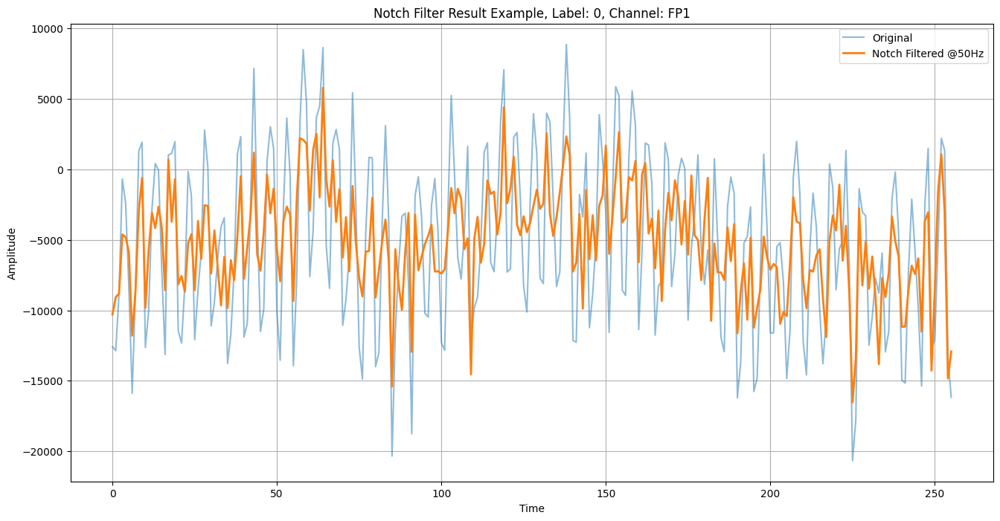

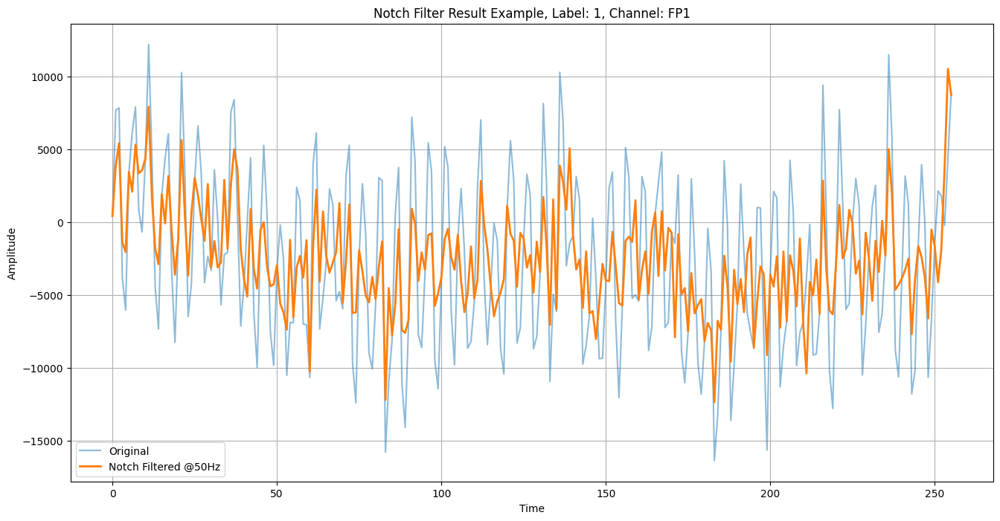

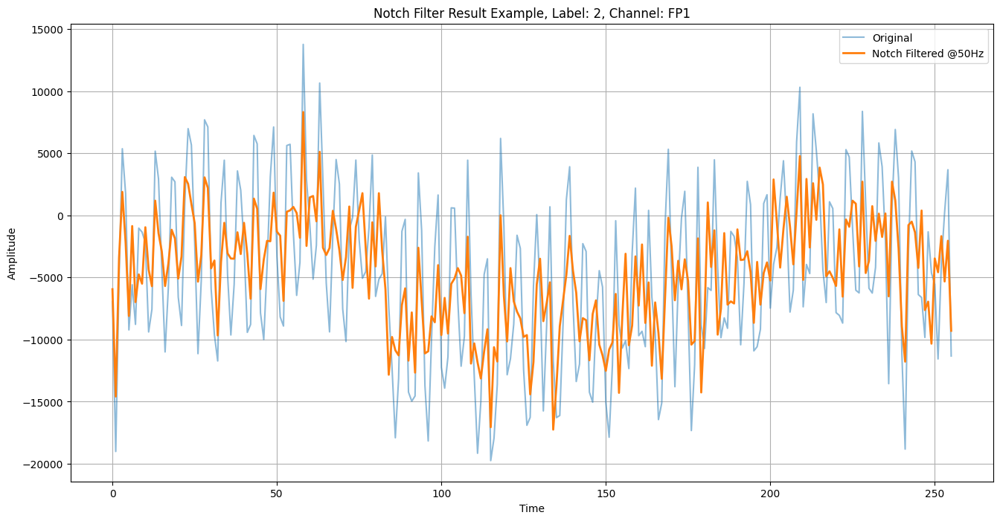

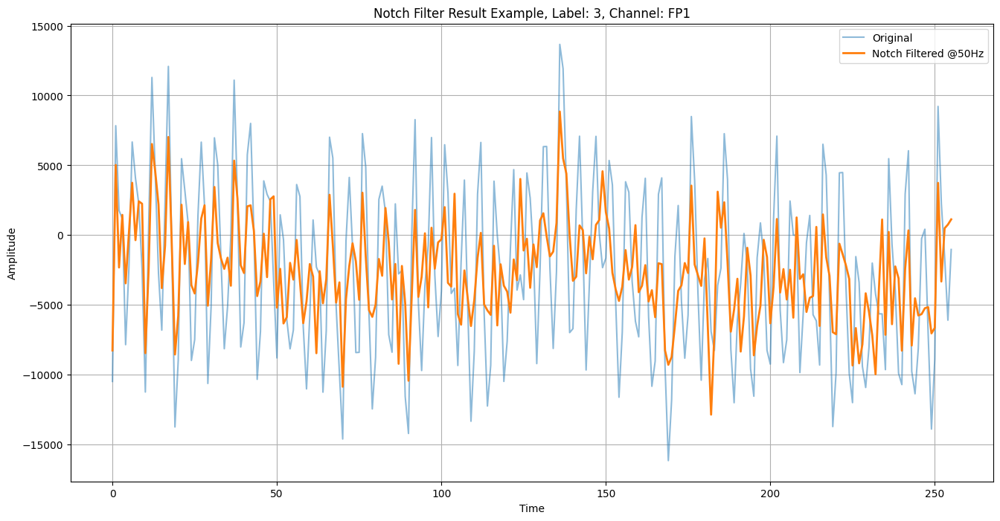

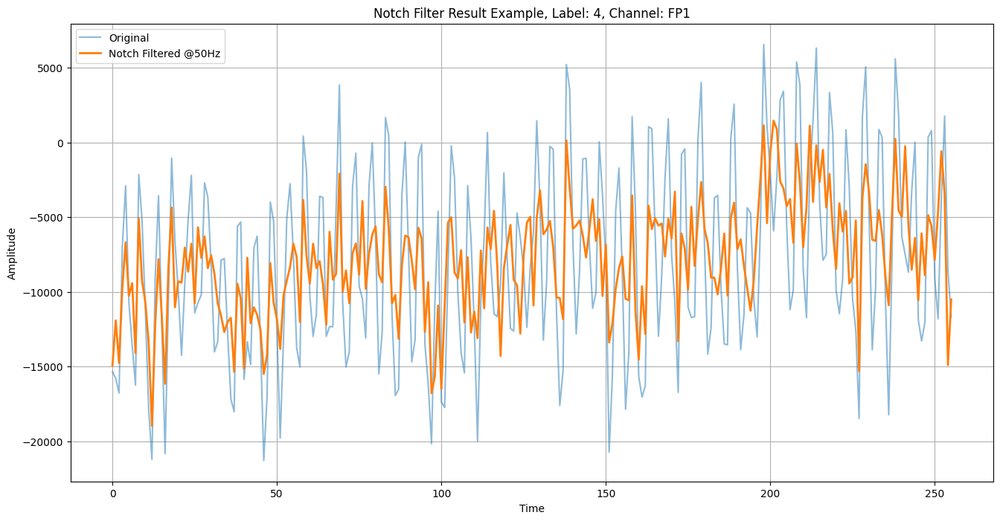

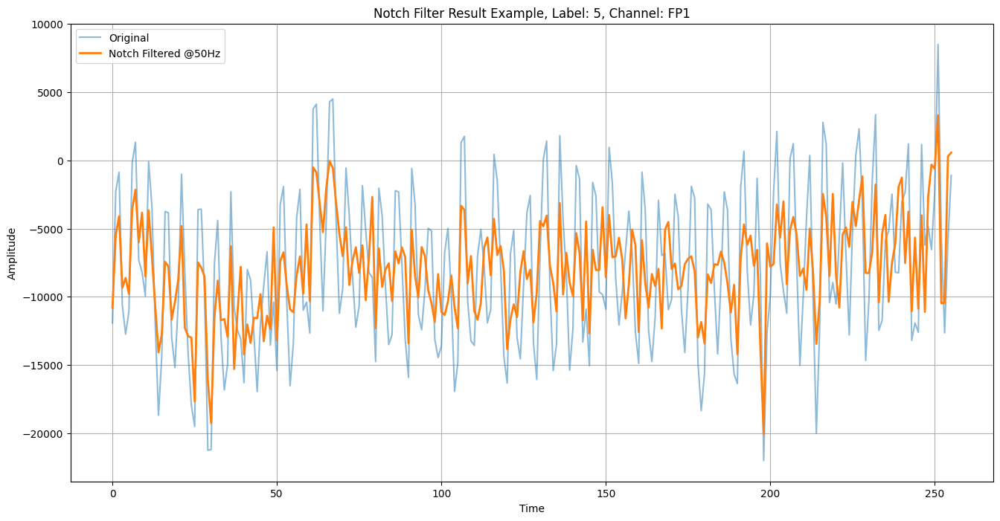

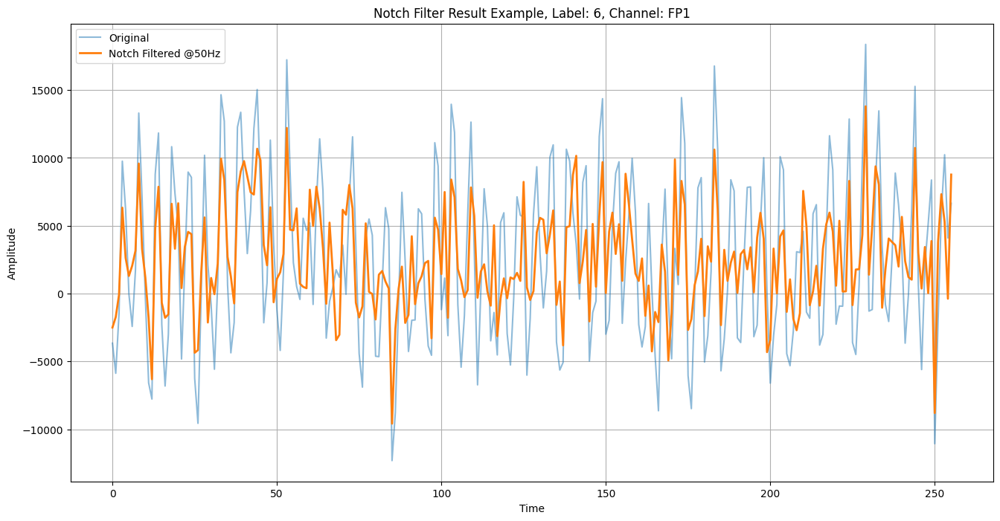

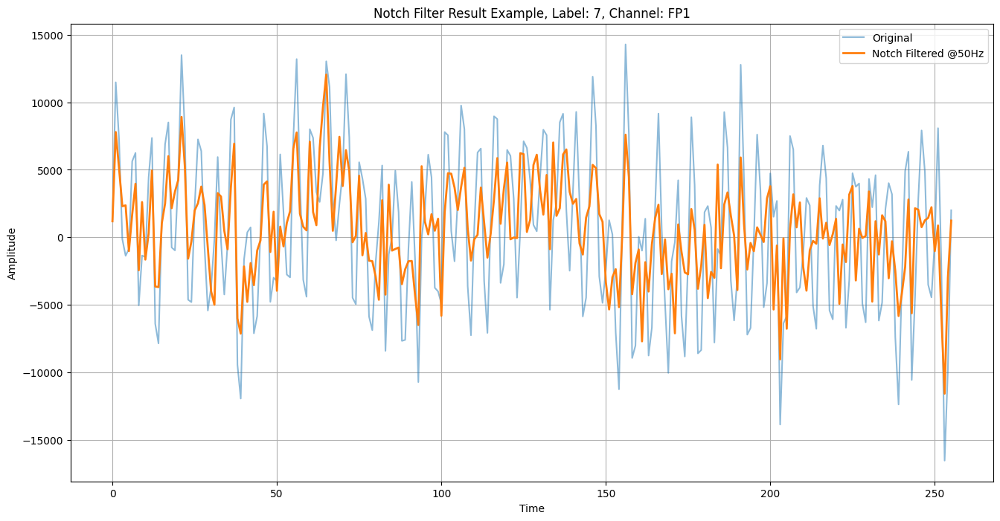

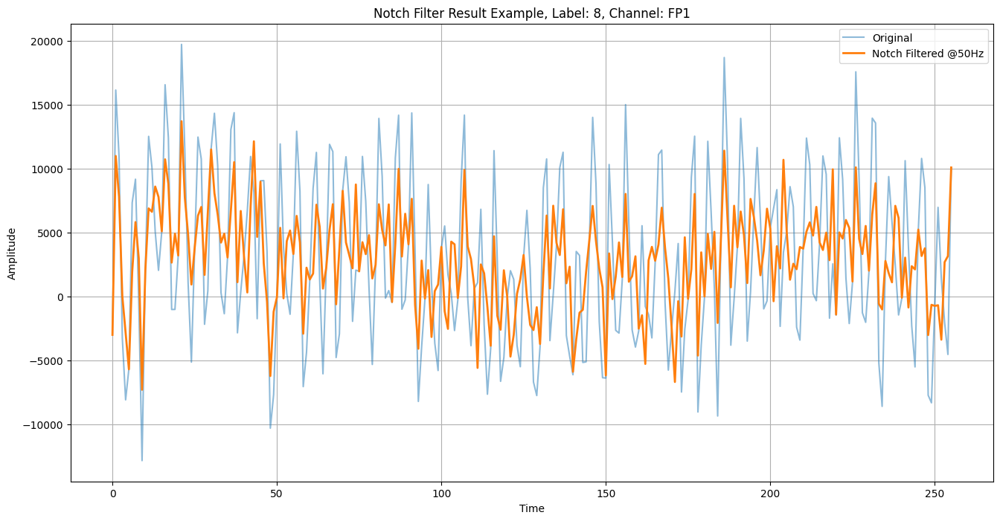

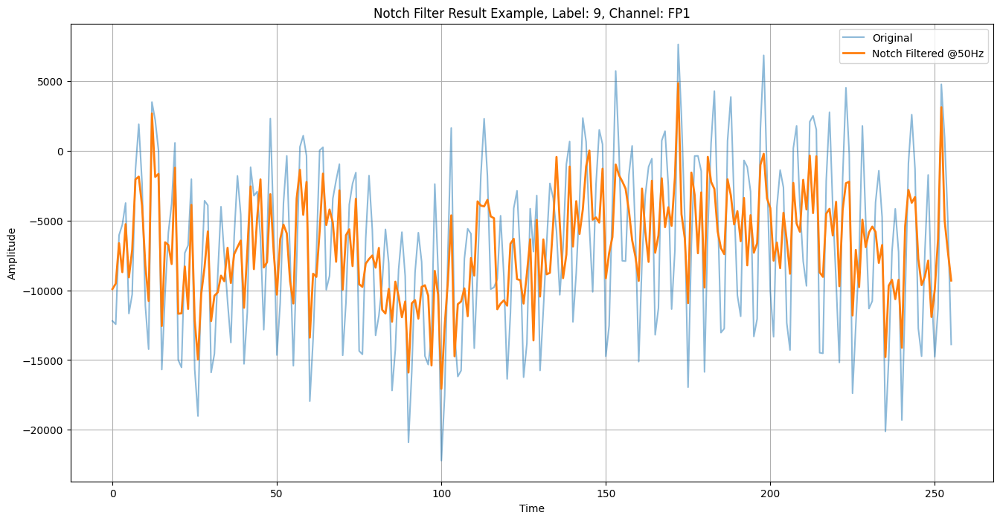

In [45]:
for i in range(10):
    idx = np.where(labels == i)[0][0]
    show_notch_filtered_difference(X, labels, notch_filtered_signals, idx, 0, "Notch Filter Result Example")

##### Frequency Domain

In [46]:
from scipy.fft import fft, fftfreq

def plot_fft(signal, fs, title):
    N = len(signal)
    yf = fft(signal)
    xf = fftfreq(N, 1 / fs)
    
    idx = np.where(xf >= 0)
    xf = xf[idx]
    yf = np.abs(yf[idx])

    plt.figure(figsize=(10, 4))
    plt.plot(xf, yf)
    plt.title(title)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Amplitude")
    plt.grid(True)
    plt.show()

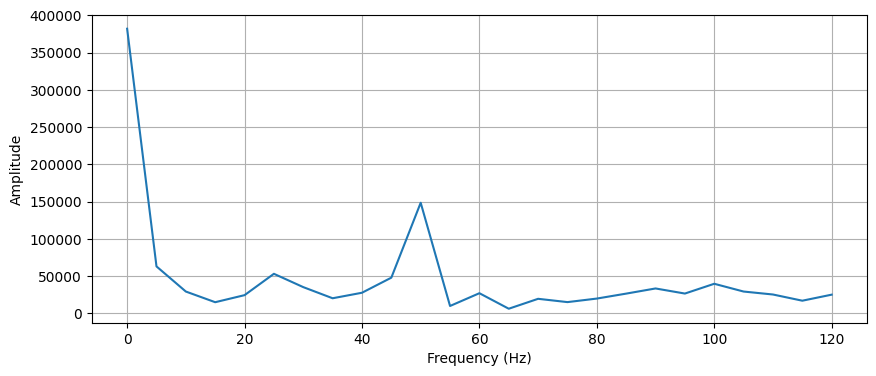

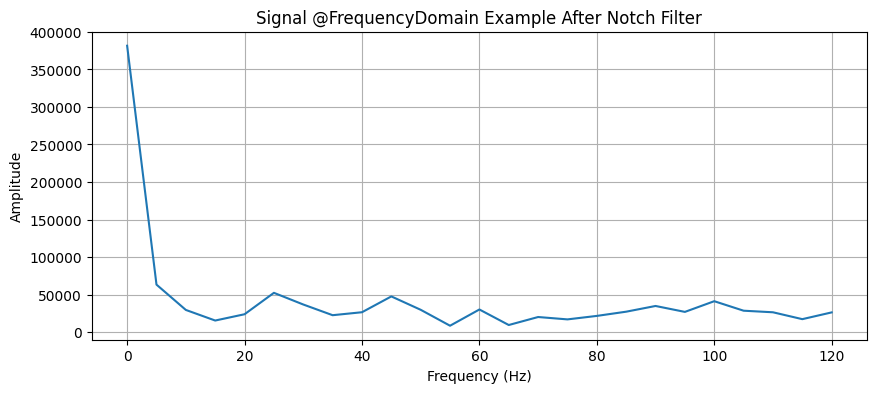

In [47]:
sample_idx = 0
channel_idx = 1

before = X[sample_idx][channel_idx][:50]
after = notch_filtered_signals[sample_idx][channel_idx][:50]

plot_fft(before, 250, "")
plot_fft(after, 250, "Signal @FrequencyDomain Example After Notch Filter")

#### Save Notch Filtered Data

In [48]:
import pickle

with open("notch_filtered_signals.pkl", "wb") as f:
    pickle.dump(notch_filtered_signals, f)

##### Retrieve Notch Filtered

In [ ]:
# TBA

### [2] Butterworth Bandpass Filter

In [49]:
from scipy.signal import butter, filtfilt

def butter_bandpass(lowcut, highcut, fs, order=5): 
    nyquist = 0.5 * fs 
    low = lowcut / nyquist 
    high = highcut / nyquist 
    b, a = butter(order, [low, high], btype='band') 
    return b, a 
    
def apply_bandpass_filter(data, lowcut, highcut, fs, order=5): 
    b, a = butter_bandpass(lowcut, highcut, fs, order=order) 
    y = filtfilt(b, a, data) 
    return y 

In [50]:
bands = {
    # 'delta': (0.5, 4),
    # 'theta': (4, 8),
    # 'alpha': (8, 13),
    # 'beta': (13, 30),
    # 'gamma': (30, 100)
    'band': (4, 30)
}

In [51]:
from collections import defaultdict

bandpass_filtered_dict = defaultdict(list)

for name, (low, high) in bands.items():
    for i in range(notch_filtered_signals.shape[0]):
        filtered_channels = []
        for ch in range(notch_filtered_signals.shape[1]):
            filtered_signal = apply_bandpass_filter(notch_filtered_signals[i, ch, :], low, high, 250)
            filtered_channels.append(filtered_signal)
        bandpass_filtered_dict[name].append(filtered_channels)

In [52]:
for key in bandpass_filtered_dict:
    bandpass_filtered_dict[key] = np.array(bandpass_filtered_dict[key])
    
for key, value in bandpass_filtered_dict.items():
    print(f"{key}: {value.shape}")

band: (30000, 32, 256)


#### Visualize Difference Example

In [ ]:
import matplotlib.pyplot as plt

def show_bandpass_filtered_difference(X_batch, labels, filtered_dict, sample_num, channel_num, title):
    original = X_batch[sample_num][channel_num]

    # Compute Scale
    # all_values = []
    # for band in filtered_dict:
    #     for sample in filtered_dict[band]:
    #         all_values.append(sample[channel_num])
    # all_values = np.concatenate(all_values)
    # y_min = all_values.min()
    # y_max = all_values.max()
    
    plt.figure(figsize=(12, 4))
    plt.plot(original, label="Original", alpha=0.5)
    for band_name in bands:
        filtered_signal = filtered_dict[band_name][sample_num][channel_num]
        low, high = bands[band_name]
        plt.plot( filtered_signal, 
                  label=f"Filtered {band_name.capitalize()}: {low}-{high} Hz", 
                  linewidth=2 )
    
    plt.title(f"{title}, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    # plt.ylim(y_min, y_max)
    plt.legend()
    plt.grid(True)
    plt.show()

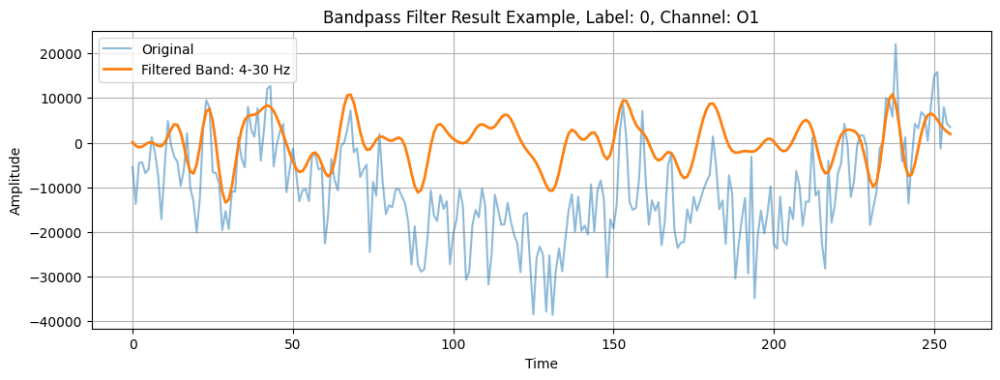

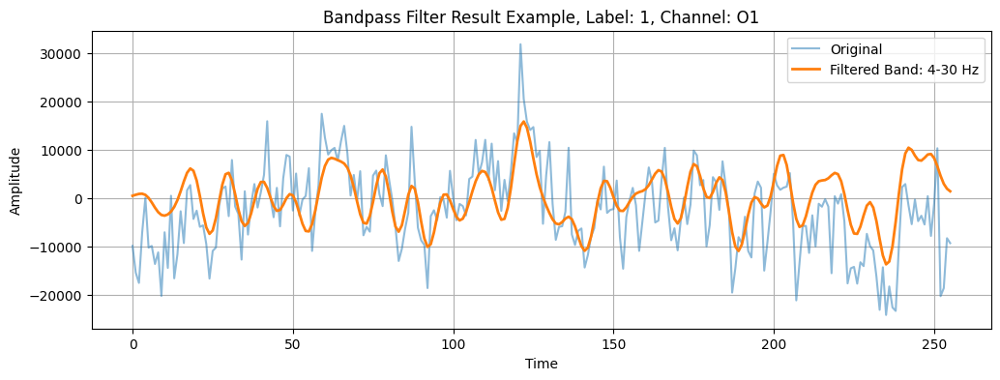

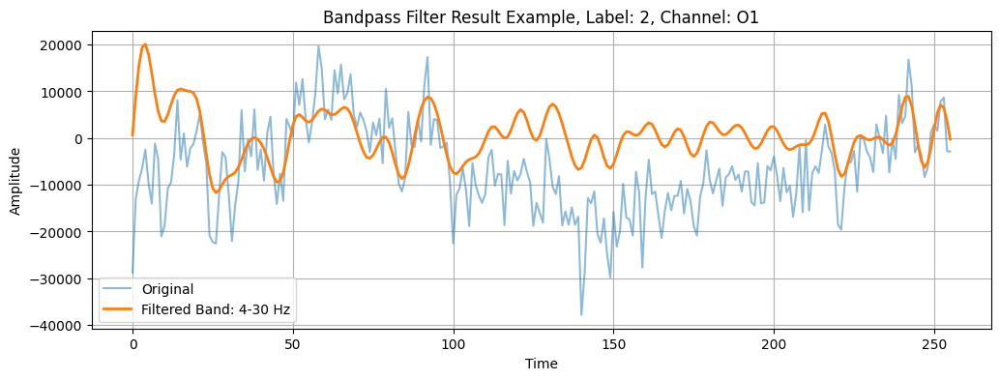

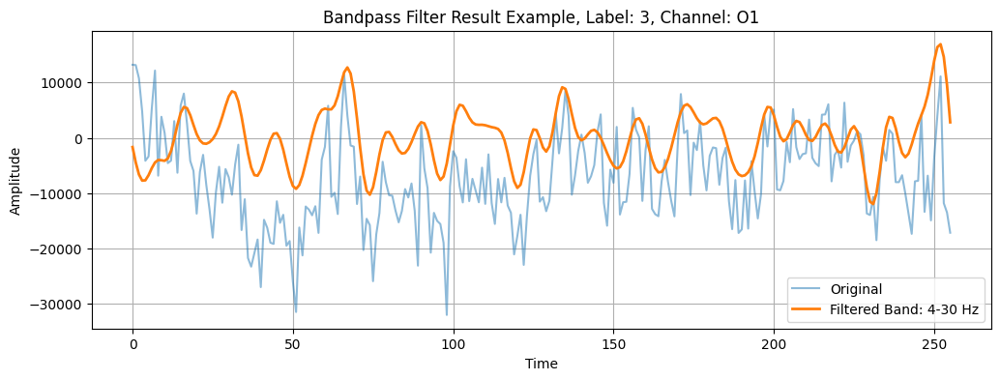

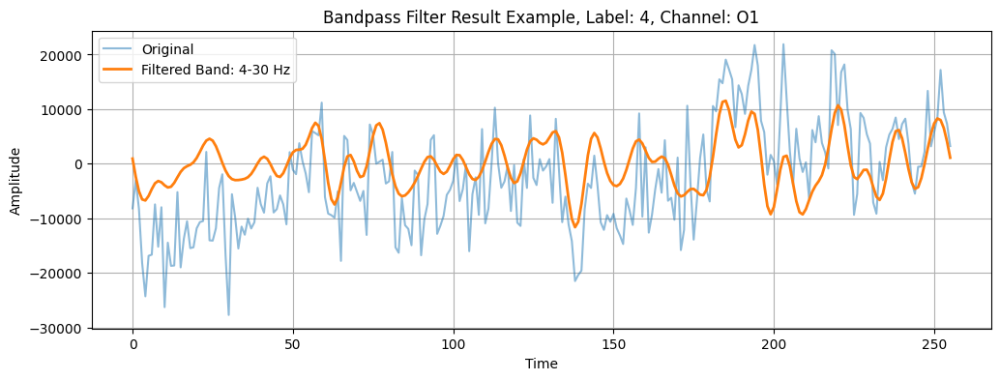

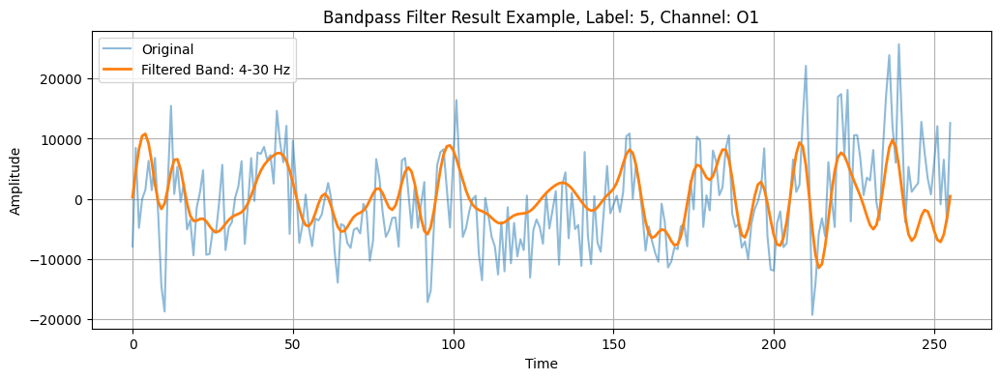

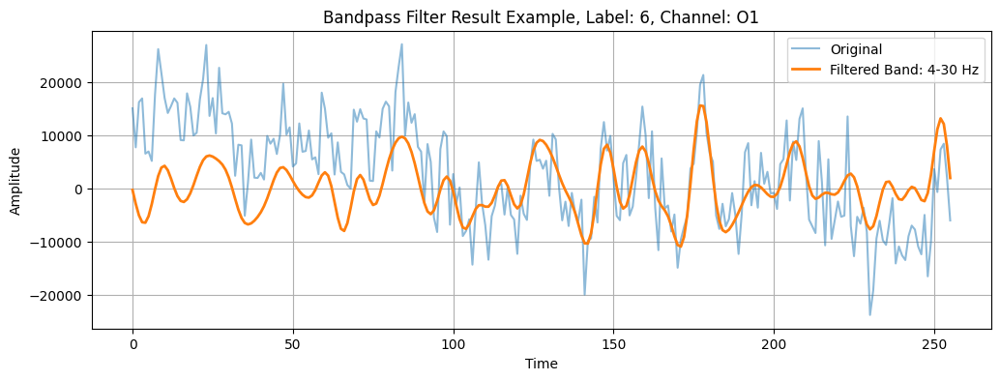

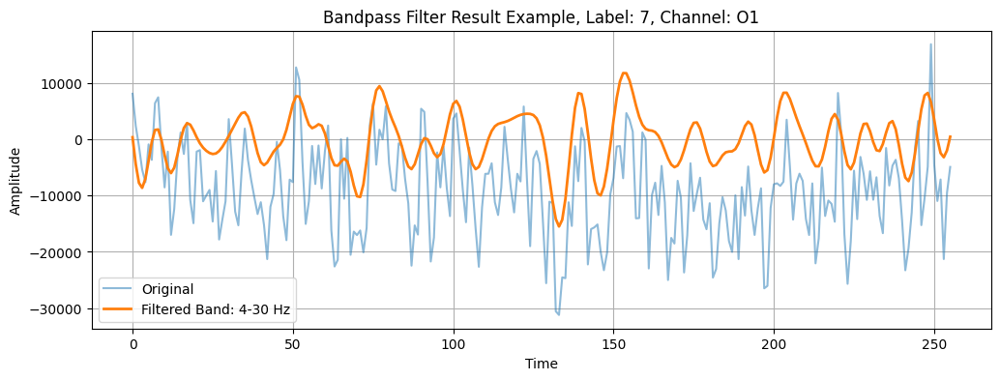

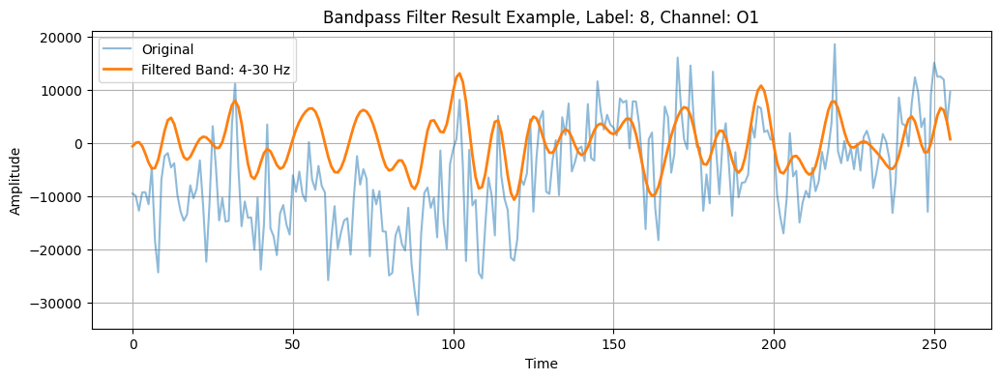

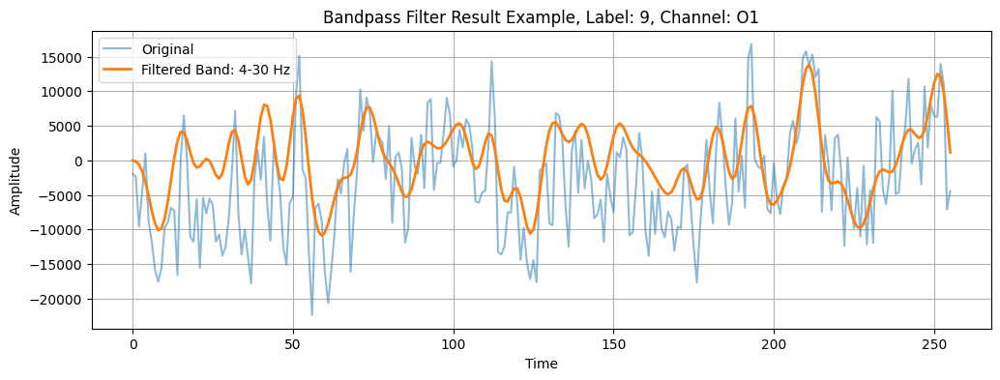

In [55]:
for i in range(10):
    idx = np.where(labels == i)[0][0]
    show_bandpass_filtered_difference(X, labels, bandpass_filtered_dict, idx, 13, "Bandpass Filter Result Example")

#### Save Bandpass Filtered Dictionary

In [56]:
import pickle

with open("bandpass_filtered_dict.pkl", "wb") as f:
    pickle.dump(bandpass_filtered_dict, f)

##### Retrieve Bandpass Filtered

In [1]:
import os
import pickle

path = "/kaggle/input/bandpass-filtered-2b-train-32ch-256ts"
with open(os.path.join(path, "bandpass_filtered_dict.pkl"), "rb") as f:
    bandpass_filtered_dict = pickle.load(f)

In [2]:
print(bandpass_filtered_dict.keys())

dict_keys(['band'])


### [3] Re-referencing

In [3]:
import numpy as np

def rereference(data):
    CAR_data = data - np.mean(data, axis=0)
    return (CAR_data)

In [4]:
rereferenced = []

for sample in bandpass_filtered_dict["band"]:
    rereferenced.append(rereference(sample))

rereferenced = np.array(rereferenced)

In [5]:
print(rereferenced.shape)
print(rereferenced[0])

(30000, 32, 256)
[[ 1.58121757e+02 -6.45962389e+02 -1.27922923e+03 ... -6.24867946e+03
  -3.80155030e+03 -5.73181570e+00]
 [ 1.48628887e+02 -1.53323509e+03 -2.73860105e+03 ... -5.33508869e+03
  -3.28022762e+03  2.86194995e+02]
 [-1.78674648e+02 -4.15537690e+02 -6.86457329e+02 ... -4.77107799e+02
  -6.57230451e+02 -6.13779268e+02]
 ...
 [ 2.37219268e+02 -1.84245479e+03 -3.56819541e+03 ... -2.99173459e+03
  -1.76108236e+03 -2.35811508e+00]
 [-5.56652332e+02  3.82045121e+02  1.46342643e+03 ... -1.51934648e+04
  -9.58641161e+03 -2.37744324e+03]
 [-5.08719357e+01 -3.93284901e+02 -1.01775520e+03 ...  1.29084677e+04
   8.11331517e+03  2.34771004e+03]]


### [4] Artifact Removal (ICA)

In [36]:
# Load Coordinates for Each Channel
import pandas as pd
import os

path = "/kaggle/input/8b-coords"
coords = pd.read_csv(os.path.join(path, "3Dcoords.csv"), header=0)

print(coords.shape)

channel_pos = {}
for i, ch_name in enumerate(channels_32):
    idx = coords[coords.iloc[:, 0] == ch_name].index
    channel_pos[f"Ch{i}"] = coords.iloc[idx[0], -3:].values.astype(float)
    
print(channel_pos.keys())

(130, 4)
dict_keys(['Ch0', 'Ch1', 'Ch2', 'Ch3', 'Ch4', 'Ch5', 'Ch6', 'Ch7', 'Ch8', 'Ch9', 'Ch10', 'Ch11', 'Ch12', 'Ch13', 'Ch14', 'Ch15', 'Ch16', 'Ch17', 'Ch18', 'Ch19', 'Ch20', 'Ch21', 'Ch22', 'Ch23', 'Ch24', 'Ch25', 'Ch26', 'Ch27', 'Ch28', 'Ch29', 'Ch30', 'Ch31'])


In [37]:
import mne
import numpy as np

montage = mne.channels.make_dig_montage(ch_pos=channel_pos, coord_frame="head")

In [10]:
import numpy as np
data = np.array(rereferenced)

fs = 250
n_channels = 32

ch_names = [f"Ch{i}" for i in range(n_channels)]
info = mne.create_info(ch_names=ch_names, sfreq=fs, ch_types="eeg")

epochs = mne.EpochsArray(data, info)
epochs.set_montage(montage)

Not setting metadata
30000 matching events found
No baseline correction applied
0 projection items activated


<EpochsArray | 30000 events (all good), 0 – 1.02 s (baseline off), ~1.83 GiB, data loaded,
 '1': 30000>

In [11]:
ica = mne.preprocessing.ICA(n_components=20, random_state=97)
ica.fit(epochs)

Fitting ICA to data using 32 channels (please be patient, this may take a while)


/tmp/ipykernel_35/1888087212.py:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(epochs)


Selecting by number: 20 components
Fitting ICA took 212.7s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,92 iterations on epochs (7680000 samples)
ICA components,20
Available PCA components,32
Channel types,eeg
ICA components marked for exclusion,—


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


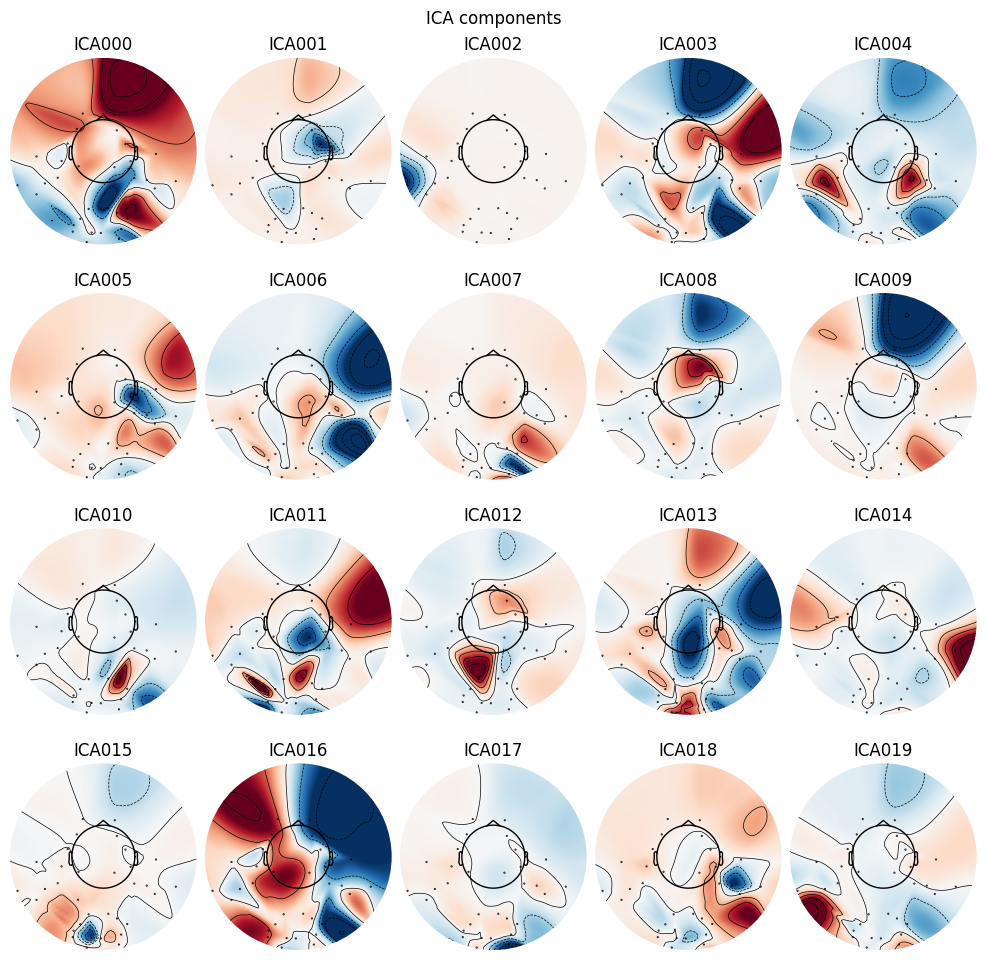

Not setting metadata
30000 matching events found
No baseline correction applied
0 projection items activated
Using matplotlib as 2D backend.


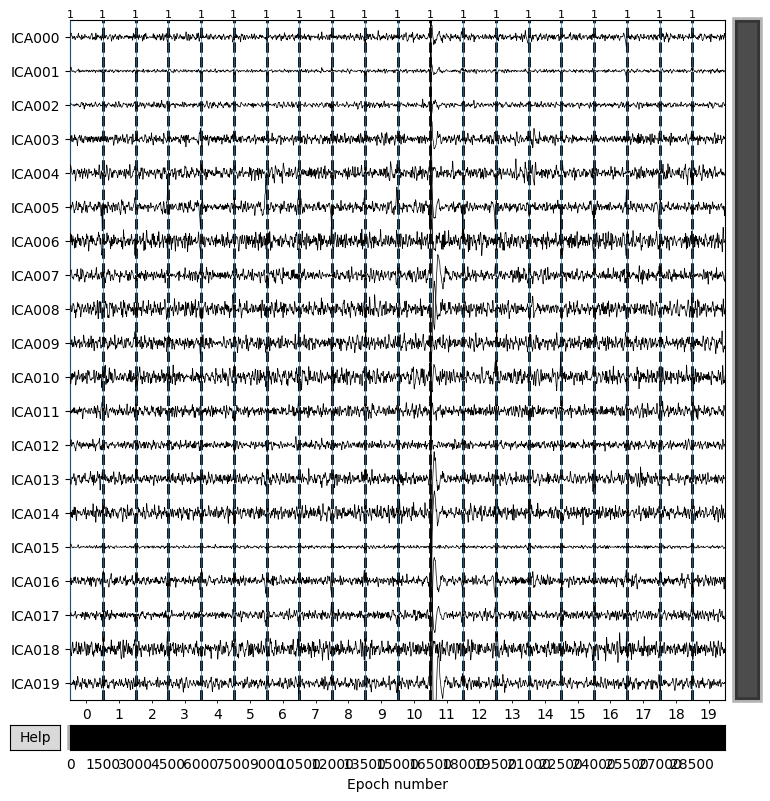

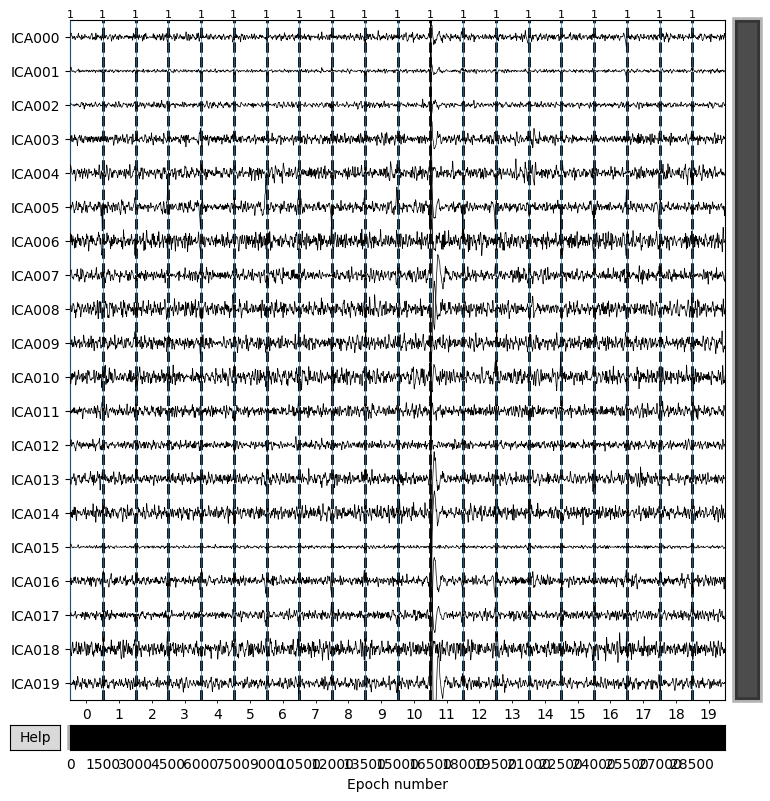

In [12]:
# Visualize to Identify Artifact Components
ica.plot_components()
ica.plot_sources(epochs)

In [14]:
# Find Noise Automatically
eog_ch = ['Ch0', 'Ch31', 'Ch1', 'Ch30', 'Ch2', 'Ch29']  # FP1, FP2, AF3, AF4, F3, F4
epochs.set_channel_types({'Ch0': 'eog', 'Ch31': 'eog'})

ica.find_bads_eog(epochs, ch_name=eog_ch)

Using EOG channels: Ch0, Ch31, Ch1, Ch30, Ch2, Ch29


([1, 8, 9, 0],
 [array([ 0.54897088,  0.19945175,  0.09034309, -0.24831672, -0.17894189,
          0.21579183, -0.09024504,  0.06011491, -0.04024768,  0.13519707,
          0.13266316,  0.04230588, -0.03181196,  0.0230794 , -0.13751949,
          0.00646351,  0.37245462,  0.01121528,  0.11705239, -0.12863091]),
  array([ 0.45735244,  0.01839436,  0.03457897, -0.39171415, -0.20800957,
          0.0319542 , -0.06499779,  0.04895255,  0.02179359, -0.70623704,
         -0.0138103 ,  0.01850258,  0.07012727,  0.06299856,  0.00592384,
         -0.0959409 , -0.22769526, -0.0682443 ,  0.05775636, -0.07881214]),
  array([ 0.63953735,  0.11090599,  0.09011298, -0.06847213, -0.20943953,
          0.20504005, -0.0769296 ,  0.08036269,  0.02411266,  0.13854927,
          0.1087233 ,  0.13349902, -0.05643904,  0.03864227, -0.09994676,
          0.01865102,  0.43124111, -0.02368285,  0.09037865, -0.09069879]),
  array([ 0.01856468, -0.42713483,  0.0322767 ,  0.33641089, -0.04666218,
          0.02459

In [15]:
ecg_ch = ['Ch6', 'Ch25', 'Ch15']  # T7, T8, POz

for ch in ecg_ch:
    print(f"Checking ECG artifact for {ch}")
    ecg_inds, scores = ica.find_bads_ecg(epochs, ch_name=ch)
    print(f"Suggested bad components from {ch}: {ecg_inds}")

Checking ECG artifact for Ch6
Using threshold: 0.32 for CTPS ECG detection
Suggested bad components from Ch6: []
Checking ECG artifact for Ch25
Using threshold: 0.32 for CTPS ECG detection
Suggested bad components from Ch25: []
Checking ECG artifact for Ch15
Using threshold: 0.32 for CTPS ECG detection
Suggested bad components from Ch15: []


In [16]:
# Components detected as artifact (human-based)
ica.exclude = [0, 1, 6, 8, 9, 16]
# Clear Artifact
ICA_cleaned = ica.apply(epochs.copy())

Applying ICA to Epochs instance
    Transforming to ICA space (20 components)
    Zeroing out 6 ICA components
    Projecting back using 32 PCA components


In [17]:
print(ICA_cleaned.get_data().shape)

(30000, 32, 256)


#### ICA Verification

In [29]:
import matplotlib.pyplot as plt

def show_sample_after_ica(sample_num, channel_num):
    original = X[sample_num][channel_num]
    bpf = bandpass_filtered_dict['band'][sample_num][channel_num]
    reref = rereferenced[sample_num][channel_num]
    filtered_signal = ICA_cleaned.get_data()[sample_num][channel_num]
    
    plt.figure(figsize=(16, 8))
    plt.plot(original, label="Original", alpha=0.5)
    
    plt.plot(bpf, label="Bandpass Filtered", alpha=0.5)
    plt.plot(reref, label="Rereferenced", alpha=0.5)
        
    plt.plot( filtered_signal, 
              label     = f"ICA Processed", 
              linewidth = 2 )
    
    plt.title(f"After ICA Example, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")
    
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.grid(True)
    plt.show()

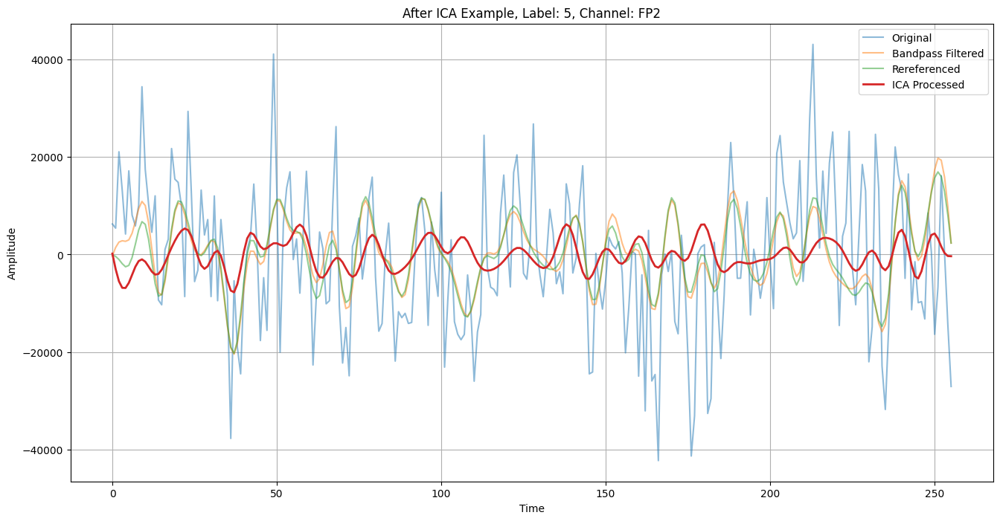

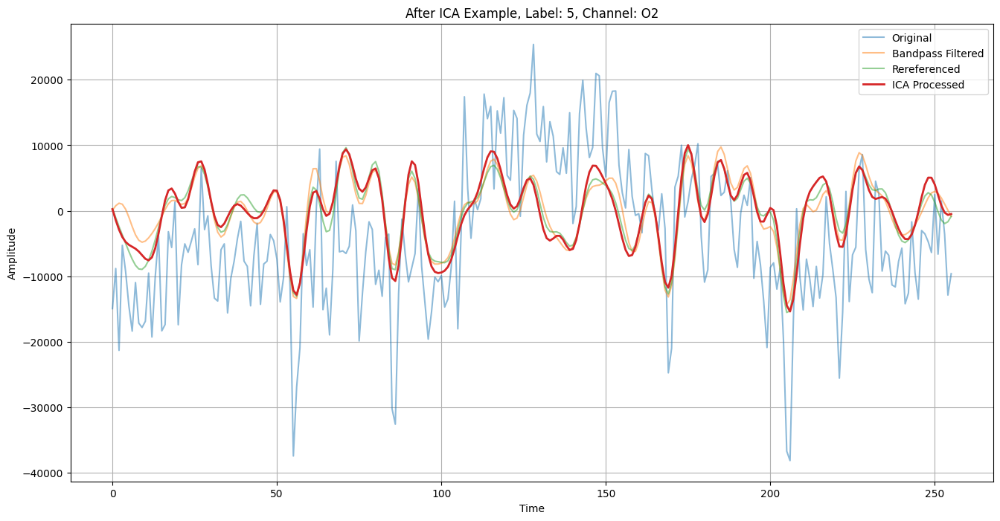

In [31]:
sample_nums = [0, 0]
channel_nums = [31, 18]

for i in range(len(sample_nums)):
    show_sample_after_ica(sample_nums[i], channel_nums[i])

#### Save ICA Result

In [41]:
import pickle

with open("ICA_cleaned.pkl", "wb") as f:
    pickle.dump(ICA_cleaned.get_data(), f)

##### Retrieve ICA Result

In [ ]:
# TBA

### [5] Baseline Correction (FIR High-Pass Filter)

In [25]:
corrected = ICA_cleaned.copy().filter (
    l_freq     = 0.1,        # Eliminate if <0.1 Hz
    h_freq     = None,       # No upper limit
    fir_design = 'firwin',   # FIR zero-phase filter
    phase      = 'zero'      # No phase distortion
)

corrected = np.array(corrected.get_data())
print(corrected.shape)

Setting up high-pass filter at 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Filter length: 8251 samples (33.004 s)



/tmp/ipykernel_35/452293949.py:1: RuntimeWarning: filter_length (8251) is longer than the signal (256), distortion is likely. Reduce filter length or filter a longer signal.
  corrected = ICA_cleaned.copy().filter (
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done 647 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done 881 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done 1457 tasks      | elapsed:    0.9s
[Parallel(n_jobs=1)]: Done 1799 tasks      | elapsed:    1.1s
[Parallel(n_jobs=1)]: Done 2177 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done 2591 tasks      | elapsed:    1.6s
[Parallel(n_jobs=1)]: Done 3041 tasks      | el

(30000, 32, 256)


In [ ]:
# NOT FOUND @5MINUTES RUN

for sample_num in range(30000):
    for channel_num in range(32):
        ICA_filtered = ICA_cleaned.get_data()[sample_num][channel_num]
        FIR_hpfiltered = corrected[sample_num][channel_num]
        if not np.array_equal(ICA_filtered, FIR_hpfiltered):
            pass

plt.figure(figsize=(16, 8))
plt.plot(ICA_filtered, label="ICA Processed", alpha=0.5)
    
plt.plot( FIR_hpfiltered, 
          label     = f"FIR HPF Processed", 
          linewidth = 2 )

plt.title(f"After FIR HPF Example, Label: {labels[sample_num]}, Channel: {channels_32[channel_num]}")

plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.legend()
plt.grid(True)
plt.show()

#### Save Corrected

In [ ]:
import pickle

with open("FIR_hpfiltered.pkl", "wb") as f:
    pickle.dump(corrected, f)

##### Retrieve Corrected

In [2]:
import os
import pickle

path = "/kaggle/input/fir-filtered-2b-train-32ch-256ts"
with open(os.path.join(path, "FIR_hpfiltered.pkl"), "rb") as f:
    corrected = pickle.load(f)

In [3]:
print(corrected.shape)

(30000, 32, 256)


### [6] Segmentation (Epoching)

In [4]:
import numpy as np

# Timestep 0-124 (125 timesteps, 500 ms)
segmented = corrected[:, :, :125]

segmented = np.array(segmented)
print(segmented.shape)

(30000, 32, 125)


### [7] Thresholding

In [11]:
import numpy as np

def threshold_channel_label(X, y, iqr_multiplier=1.5, max_outlier_channels=3, channel_names=None):
    # Source: ChatGPT
    n_samples, n_channels, n_times = X.shape
    valid_mask = np.ones(n_samples, dtype=bool)

    labels = np.unique(y)
    outlier_channel_counter = np.zeros(n_channels, dtype=int)
    
    for label in labels:
        # Process per label
        idx = np.where(y == label)[0]
        X_label = X[idx]

        # Process per channel
        X_flat = X_label.transpose(1, 0, 2).reshape(n_channels, -1)
        Q1 = np.percentile(X_flat, 25, axis=1)
        Q3 = np.percentile(X_flat, 75, axis=1)
        IQR = Q3 - Q1

        lower = (Q1 - iqr_multiplier * IQR).reshape(1, n_channels, 1)
        upper = (Q3 + iqr_multiplier * IQR).reshape(1, n_channels, 1)

        # Detect outlier
        too_low = X_label < lower
        too_high = X_label > upper
        outlier_mask = np.logical_or(too_low, too_high)  # shape: (n_label_samples, n_channels, n_times)

        # Count outlier channel per sample
        outlier_per_channel = np.any(outlier_mask, axis=2)  # shape: (n_samples_label, n_channels)
        num_outlier_channels = np.sum(outlier_per_channel, axis=1)  # shape: (n_samples_label,)

        # THRESHOLDING STRATEGY
        is_valid_label = num_outlier_channels <= max_outlier_channels

        # Update global mask
        valid_mask[idx] = is_valid_label

        # Count to know problematic channels
        # Count only from "to discard" samples
        bad_samples = np.where(~is_valid_label)[0]
        for i in bad_samples:
            outlier_channel_counter += outlier_per_channel[i].astype(int)

    X_cleaned = X[valid_mask]
    y_cleaned = y[valid_mask]
    valid_indices = np.where(valid_mask)[0]

    if channel_names is not None:
        outlier_channel_freq = {name: count for name, count in zip(channel_names, outlier_channel_counter)}
    else:
        outlier_channel_freq = {f"Ch{i}": count for i, count in enumerate(outlier_channel_counter)}

    print(f"Sample count (before) : {X.shape[0]}")
    print(f"Valid sample count    : {X_cleaned.shape[0]}")
    print(f"Discarded sample      : {np.sum(~valid_mask)}")
    print(f"Problematic channels  :")
    print("      ", outlier_channel_freq)

    return X_cleaned, y_cleaned, outlier_channel_freq, valid_indices

In [19]:
X_filtered, y_filtered, outlier_channel_freq, valid_indices = threshold_channel_label(segmented, labels, 1.5, 0, channels_32)

Sample count (before) : 30000
Valid sample count    : 7
Discarded sample      : 29993
Problematic channels  :
       {'FP1': 15376, 'AF3': 14660, 'F3': 16341, 'FC1': 15789, 'C3': 17018, 'FC3': 17184, 'T7': 15360, 'CP5': 15373, 'CPP1h': 15755, 'P1': 15528, 'P7': 15405, 'P9': 13642, 'PO3': 14459, 'O1': 14680, 'OI1h': 15053, 'POz': 15132, 'Oz': 15570, 'OI2h': 14927, 'O2': 17570, 'PO4': 13910, 'P10': 15402, 'P8': 14247, 'P2': 16219, 'CPP2h': 13520, 'CP6': 15020, 'T8': 14275, 'FC4': 17906, 'C4': 14883, 'FC2': 12965, 'F4': 13841, 'AF4': 14449, 'FP2': 14054}


In [20]:
X_filtered, y_filtered, outlier_channel_freq, valid_indices = threshold_channel_label(segmented, labels, 1.5, 5, channels_32)

Sample count (before) : 30000
Valid sample count    : 1114
Discarded sample      : 28886
Problematic channels  :
       {'FP1': 15274, 'AF3': 14497, 'F3': 16067, 'FC1': 15568, 'C3': 16873, 'FC3': 17009, 'T7': 15278, 'CP5': 15214, 'CPP1h': 15622, 'P1': 15433, 'P7': 15233, 'P9': 13548, 'PO3': 14352, 'O1': 14590, 'OI1h': 14883, 'POz': 15041, 'Oz': 15108, 'OI2h': 14639, 'O2': 17433, 'PO4': 13861, 'P10': 15284, 'P8': 14176, 'P2': 16085, 'CPP2h': 13454, 'CP6': 14903, 'T8': 14216, 'FC4': 17681, 'C4': 14784, 'FC2': 12879, 'F4': 13817, 'AF4': 14415, 'FP2': 14015}


In [22]:
X_filtered, y_filtered, outlier_channel_freq, valid_indices = threshold_channel_label(segmented, labels, 1.5, 10, channels_32)

Sample count (before) : 30000
Valid sample count    : 5485
Discarded sample      : 24515
Problematic channels  :
       {'FP1': 14181, 'AF3': 13441, 'F3': 14613, 'FC1': 14171, 'C3': 15654, 'FC3': 15440, 'T7': 14142, 'CP5': 13906, 'CPP1h': 14288, 'P1': 14325, 'P7': 14006, 'P9': 12535, 'PO3': 13404, 'O1': 13541, 'OI1h': 13696, 'POz': 13901, 'Oz': 13045, 'OI2h': 13180, 'O2': 16015, 'PO4': 13275, 'P10': 14083, 'P8': 13220, 'P2': 14812, 'CPP2h': 12648, 'CP6': 13696, 'T8': 13420, 'FC4': 16136, 'C4': 13678, 'FC2': 11918, 'F4': 13254, 'AF4': 13585, 'FP2': 13367}


In [12]:
X_filtered, y_filtered, outlier_channel_freq, valid_indices = threshold_channel_label(segmented, labels, 1.5, 15, channels_32)

Sample count (before) : 30000
Valid sample count    : 13716
Discarded sample      : 16284
Problematic channels  :
       {'FP1': 10750, 'AF3': 10096, 'F3': 10950, 'FC1': 10410, 'C3': 11584, 'FC3': 11483, 'T7': 10719, 'CP5': 10410, 'CPP1h': 10885, 'P1': 10878, 'P7': 10549, 'P9': 9494, 'PO3': 10390, 'O1': 10191, 'OI1h': 10557, 'POz': 10385, 'Oz': 8823, 'OI2h': 9482, 'O2': 11908, 'PO4': 10647, 'P10': 10442, 'P8': 10217, 'P2': 11155, 'CPP2h': 9964, 'CP6': 10148, 'T8': 10597, 'FC4': 11887, 'C4': 10416, 'FC2': 8975, 'F4': 10724, 'AF4': 10727, 'FP2': 10629}


In [24]:
import numpy as np

unique, counts = np.unique(y_filtered, return_counts=True)
print("Sample count per label (AFTER thresholding):")
for label, count in zip(unique, counts):
    print(f"Label {label}: {count} samples")

Sample count per label (AFTER thresholding):
Label 0: 1336 samples
Label 1: 1546 samples
Label 2: 1340 samples
Label 3: 1408 samples
Label 4: 1336 samples
Label 5: 1251 samples
Label 6: 1383 samples
Label 7: 1454 samples
Label 8: 1309 samples
Label 9: 1353 samples


In [25]:
fully_usable_channels = [ch for ch in channels_32 if ch not in outlier_channel_freq.keys()]
print(fully_usable_channels)

[]


In [15]:
import numpy as np
np.save("thresholded_valid_indices.npy", valid_indices)

### [8] Normalization

In [27]:
from sklearn.preprocessing import StandardScaler

def normalize_channels(eeg):
    n_samples, n_channels, n_timesteps = eeg.shape
    reshaped = eeg.transpose(1, 0, 2).reshape(n_channels, -1).T
    
    scaler = StandardScaler()
    scaled = scaler.fit_transform(reshaped)
    
    scaled_data = scaled.T.reshape(n_channels, n_samples, n_timesteps).transpose(1, 0, 2)
    return (scaled_data, scaler)

In [28]:
normalized, scalers = normalize_channels(X_filtered)
print(normalized.shape)
print(normalized[0])

(13716, 32, 125)
[[ 0.08286163 -0.28043111 -0.65459223 ...  0.14127202  0.33081476
   0.45843364]
 [ 0.07258023 -0.64297446 -1.26671713 ... -0.48876556 -0.17105856
   0.08305014]
 [-0.02887468 -0.12150799 -0.25991547 ... -0.5043823  -0.94104856
  -1.16663161]
 ...
 [ 0.05946879  0.36564511  0.64579396 ...  0.81550721  0.74252625
   0.42794129]
 [ 0.00355683  0.66249767  1.19593567 ...  0.24545345  0.0770954
  -0.09484126]
 [ 0.05313872 -0.85320862 -1.56528409 ...  0.28208309  0.38587929
   0.3821653 ]]


In [29]:
# How to Access Standard Scalers
print (scalers.mean_)  #mean
print (scalers.scale_) #std

[ 3.16867031 -0.74769599 -0.29530457 -0.40616415  1.52385117  0.22894784
  1.82729652 -6.68622541  3.94181558 -0.65651452 -3.01181588  2.90382955
  2.21018035  0.81785116 -0.57840929 -5.47533927 -2.88213575  1.21738337
  2.50196525 -4.52092171 -1.94553278  3.77610389 -1.02400594  3.10557942
 -2.72898106 10.1173143  -0.0957957  -8.36484588  0.95215755 -0.05348668
  8.06665255 -1.30942479]
[2174.47020513 2250.68631905 2202.81152614 1991.35034608 1958.99147366
 2766.28892078 2755.78333016 5090.31517686 5312.92416432 2429.26191306
 3639.4046997  5259.72313571 3181.53529393 2855.75273375 3151.90455519
 3519.79653763 5413.89958935 5335.90316056 6063.4225143  4832.34836107
 4873.1907379  1950.30627459 5970.22714215 3481.01107002 5114.30486786
 4415.90704619 5327.09527271 4888.77031363 5103.8025491  1209.43299771
 3618.18486379 3503.24761114]


#### Save Normalized and Scaler

In [ ]:
import joblib

np.save('eeg_normalized.npy', normalized)
np.save('y_filtered.npy', y_filtered)
joblib.dump(scalers, 'scaler.pkl')

##### Retrieved Normalized and Scaler

In [ ]:
# TBA

### [9] Common Spatial Filtering

In [38]:
from pyriemann.estimation import Covariances
from pyriemann.spatialfilters import CSP
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

pipeline = Pipeline([
    ('cov', Covariances(estimator='oas')),
    ('csp', CSP(nfilter=4, log=True)),
    ('clf', LogisticRegression(max_iter=1000))
])

param_grid = {
    'csp__nfilter': [2, 4, 6, 8],
    'clf__C'      : [0.01, 0.1, 1, 10]
}

search = GridSearchCV(pipeline, param_grid, cv=5, verbose=0, n_jobs=1)
search.fit(normalized[:12000].astype('float64'), y_filtered[:12000])

# Evaluation on TRAIN SET
print("Best parameters:", search.best_params_)
print("Train score:", search.best_score_)

# Evaluation on TEST SET
score = search.score(normalized[-1716:].astype('float64'), y_filtered[-1716:])
print("Test score:", score)

Best parameters: {'clf__C': 0.01, 'csp__nfilter': 2}
Train score: 0.10974999999999999
Test score: 0.10431235431235432


In [39]:
csp_patterns = search.best_estimator_.named_steps['csp'].patterns_
csp_filters = search.best_estimator_.named_steps['csp'].filters_

print("CSP Patterns shape:", csp_patterns.shape)
print("CSP Filters shape:", csp_filters.shape)

CSP Patterns shape: (2, 32)
CSP Filters shape: (2, 32)


### [10] Augmentation and Upsampling

#### Augmentation Functions

In [44]:
def gaussian_noise(x, scale=0.2):
    std = np.std(x)
    return x + np.random.normal(0, scale * std, size=x.shape)

def jitter(x, scale=0.2):
    std = np.std(x)
    return x + np.random.normal(0, scale * std, size=x.shape)

def mixup(x1, x2, alpha=0.4):
    lam = np.random.beta(alpha, alpha)
    return lam * x1 + (1 - lam) * x2, lam

#### Upsampling with Random Augmentation Function

In [45]:
from collections import Counter

def upsample_with_augmentation(X, y):
    counter = Counter(y)
    max_count = max(counter.values())

    X_augmented = []
    y_augmented = []

    augmented_indices = []
    augmentation_methods = []
    duplication_sources = []

    original_length = len(X)

    # Process per label
    for label in sorted(counter.keys()):
        X_class = X[y == label]
        # Index from original data
        class_indices_global = np.where(y == label)[0]

        n_to_generate = max_count - len(X_class)
        for _ in range(n_to_generate):
            method = np.random.choice(['gaussian', 'jitter', 'mixup'])

            if method == 'gaussian':
                idx = np.random.randint(0, len(X_class))
                x = X_class[idx]
                x_aug = gaussian_noise(x)
                source = class_indices_global[idx]
    
            elif method == 'jitter':
                idx = np.random.randint(0, len(X_class))
                x = X_class[idx]
                x_aug = jitter(x)
                source = class_indices_global[idx]
    
            elif method == 'mixup':
                i1, i2 = np.random.choice(len(X_class), 2, replace=True)
                x1, x2 = X_class[i1], X_class[i2]
                x_aug, lam = mixup(x1, x2)
                source = ((class_indices_global[i1], class_indices_global[i2]), lam)
    
            X_augmented.append(x_aug)
            y_augmented.append(label)
            augmentation_methods.append(method)
            duplication_sources.append(source)


    # Shuffle Augmenteds
    perm = np.random.permutation(len(X_augmented))
    X_augmented = [X_augmented[i] for i in perm]
    y_augmented = [y_augmented[i] for i in perm]
    augmentation_methods = [augmentation_methods[i] for i in perm]
    duplication_sources = [duplication_sources[i] for i in perm]

    # Integrate with Original Data
    X_final = np.concatenate([X, np.array(X_augmented)], axis=0)
    y_final = np.concatenate([y, np.array(y_augmented)], axis=0)    
    augmented_indices = list(range(original_length, original_length + len(X_augmented)))

    return (
        X_final, 
        y_final,
        augmented_indices,
        augmentation_methods,
        duplication_sources
    )

In [46]:
X_upsampled, y_upsampled, aug_idx, aug_methods, dup_sources = upsample_with_augmentation(normalized, y_filtered)

In [47]:
X_upsampled = np.array(X_upsampled)
y_upsampled = np.array(y_upsampled)
                      
print(X_upsampled.shape)
print(y_upsampled.shape)

(15460, 32, 125)
(15460,)


In [48]:
counter_original = Counter(y_filtered)
counter_upsampled = Counter(y_upsampled)
counter_methods = Counter(aug_methods)

print(counter_original)
print(counter_upsampled)
print(counter_methods)

Counter({1: 1546, 7: 1454, 3: 1408, 6: 1383, 9: 1353, 2: 1340, 0: 1336, 4: 1336, 8: 1309, 5: 1251})
Counter({5: 1546, 0: 1546, 4: 1546, 1: 1546, 9: 1546, 2: 1546, 3: 1546, 6: 1546, 7: 1546, 8: 1546})
Counter({'jitter': 596, 'gaussian': 584, 'mixup': 564})


## Data Review (After Denoising)

In [53]:
# METRICS
print_metrics(calculate_metrics(X_upsampled.reshape(X_upsampled.shape[0], -1), y_upsampled))



=================================================== METRICS  SUMMARY ===================================================
Label      | Theta Min       | Theta Max       | Theta Avg       | Euclidean Min   | Euclidean Max   | Euclidean Avg  
------------------------------------------------------------------------------------------------------------------------
0          | 0.000816        | 111.888098      | 89.946441       | 0.001251        | 191.604372      | 88.690243      
1          | 66.176706       | 112.628966      | 89.967041       | 55.906490       | 154.779352      | 88.993111      
2          | 0.001002        | 113.477052      | 89.952233       | 0.001623        | 145.696490      | 89.061357      
3          | 0.000015        | 114.293052      | 89.962677       | 0.000020        | 156.114996      | 89.125675      
4          | 0.000087        | 115.813293      | 89.950916       | 0.000206        | 210.248493      | 88.735325      
5          | 0.004797        | 116.324528 

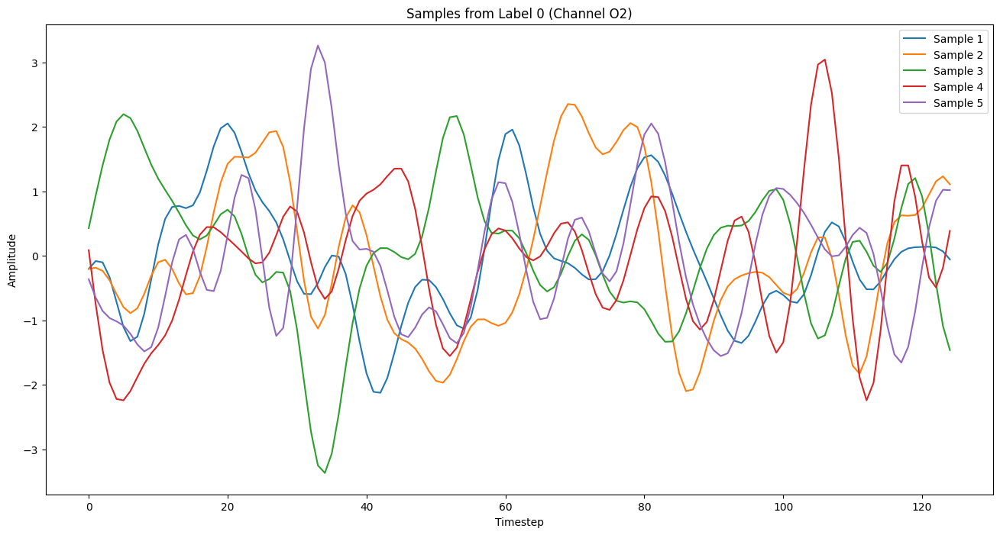

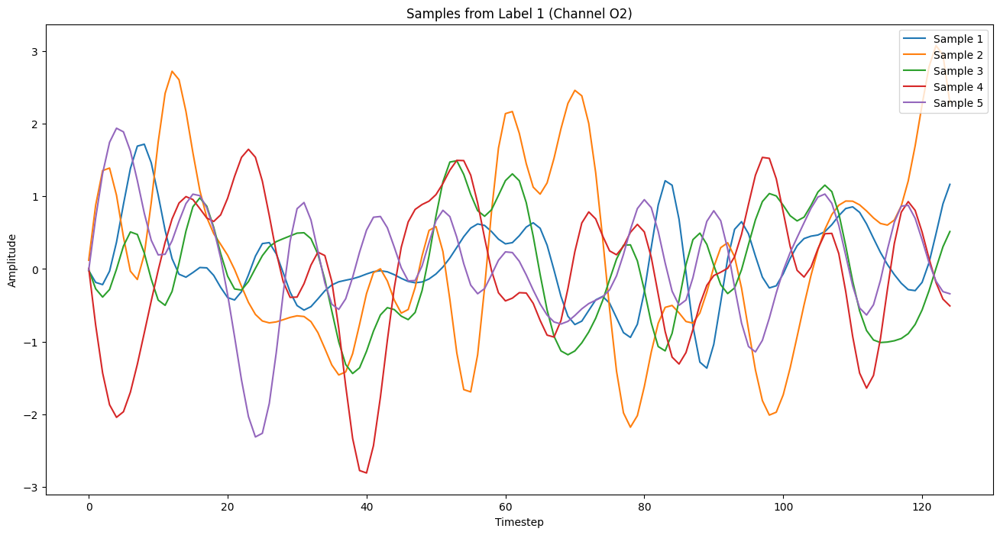

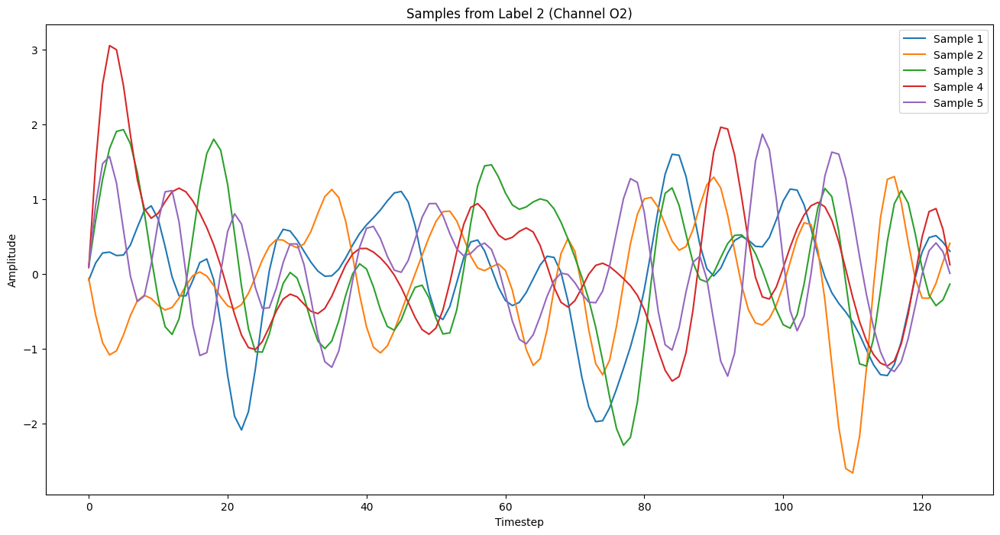

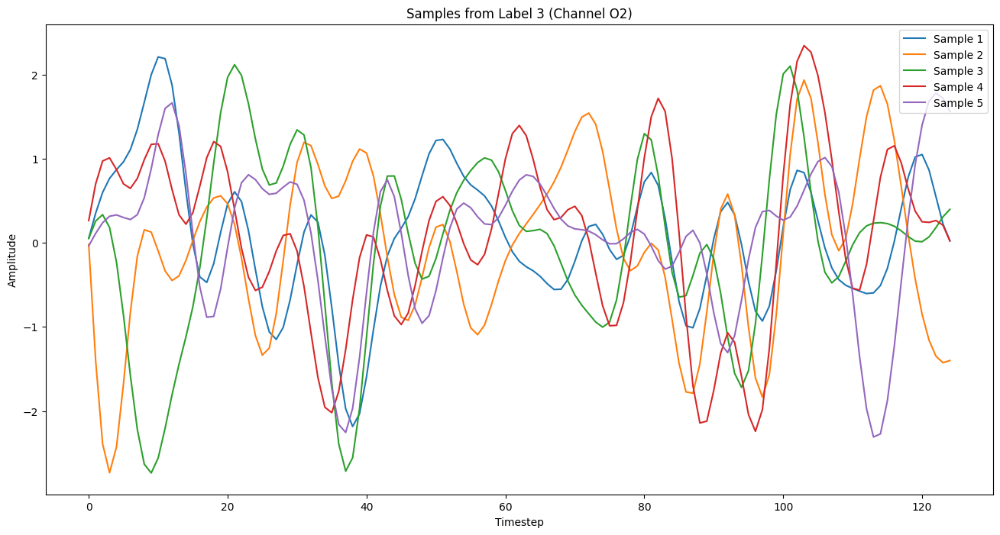

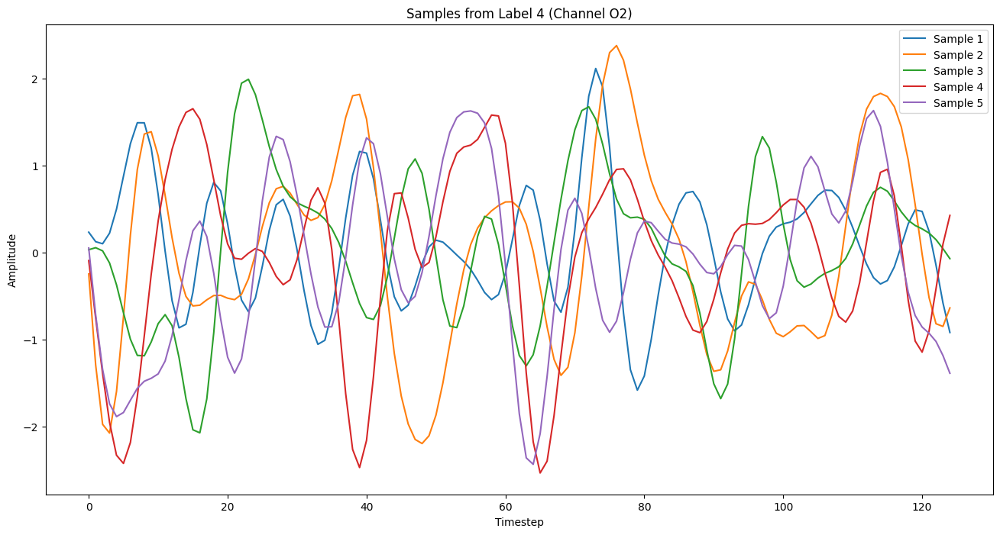

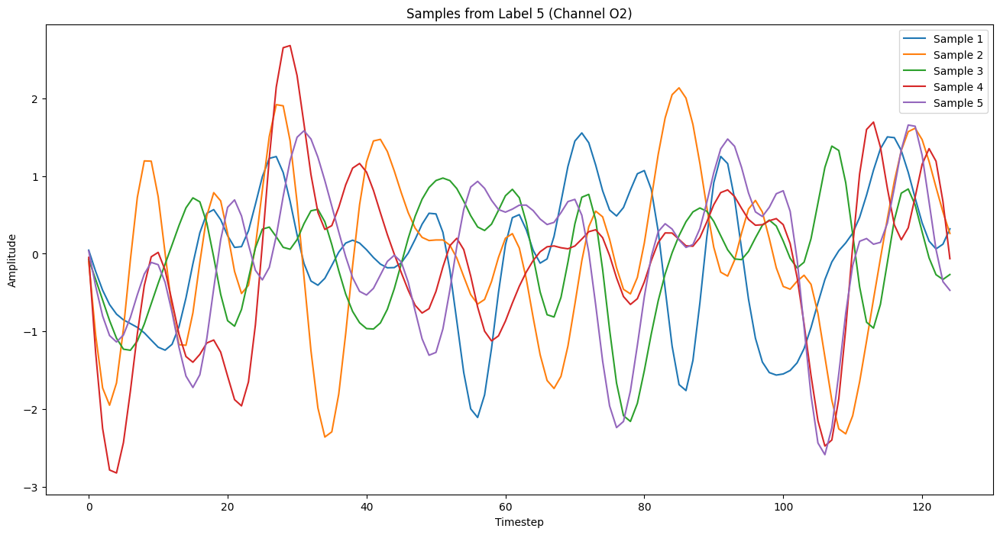

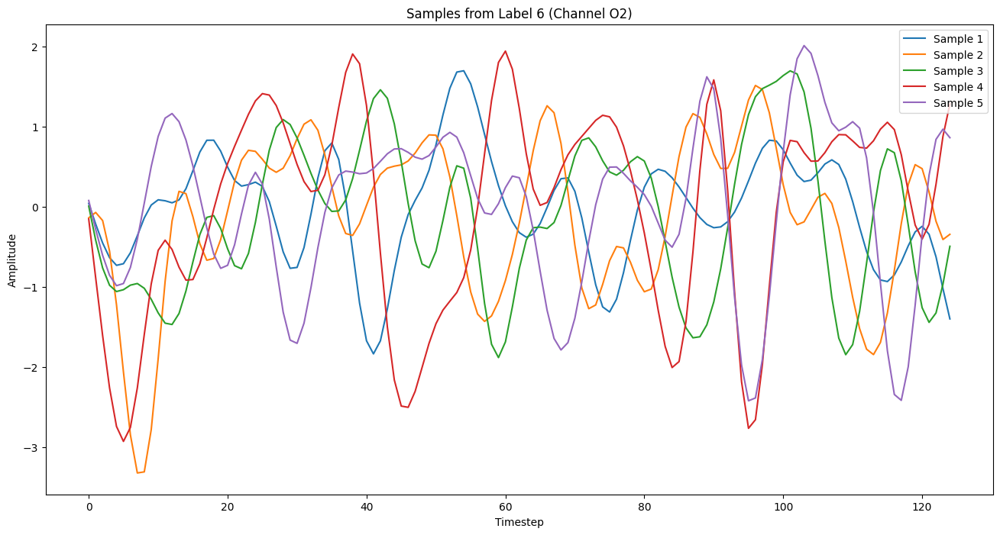

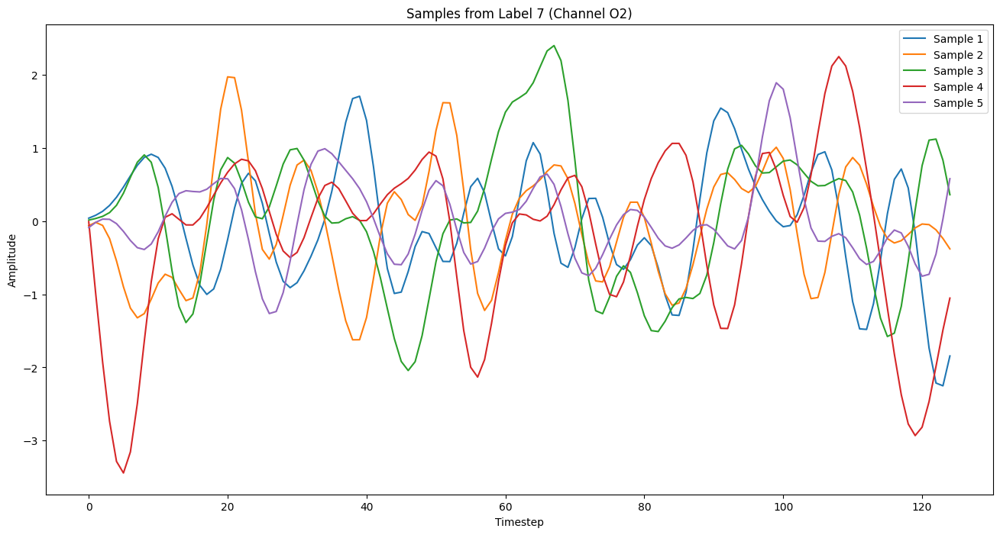

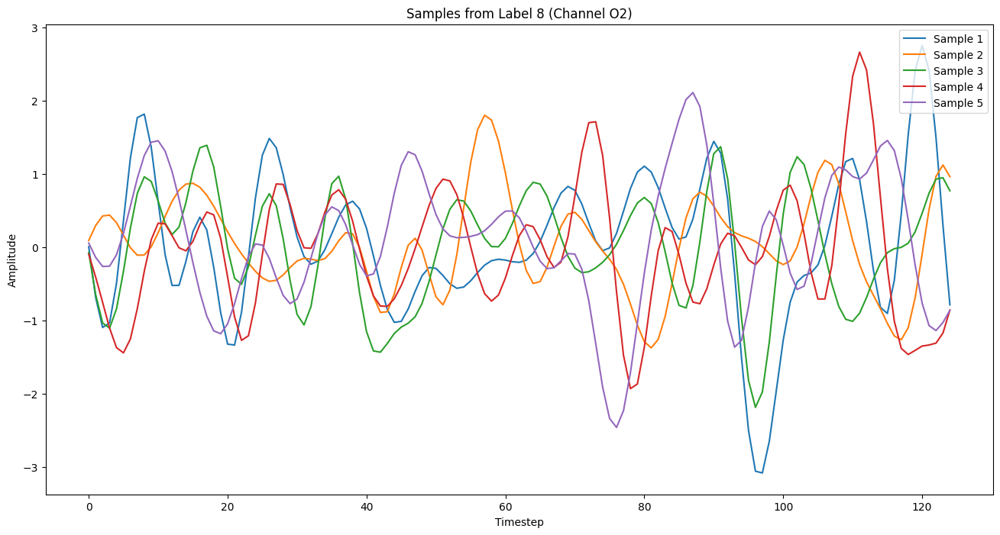

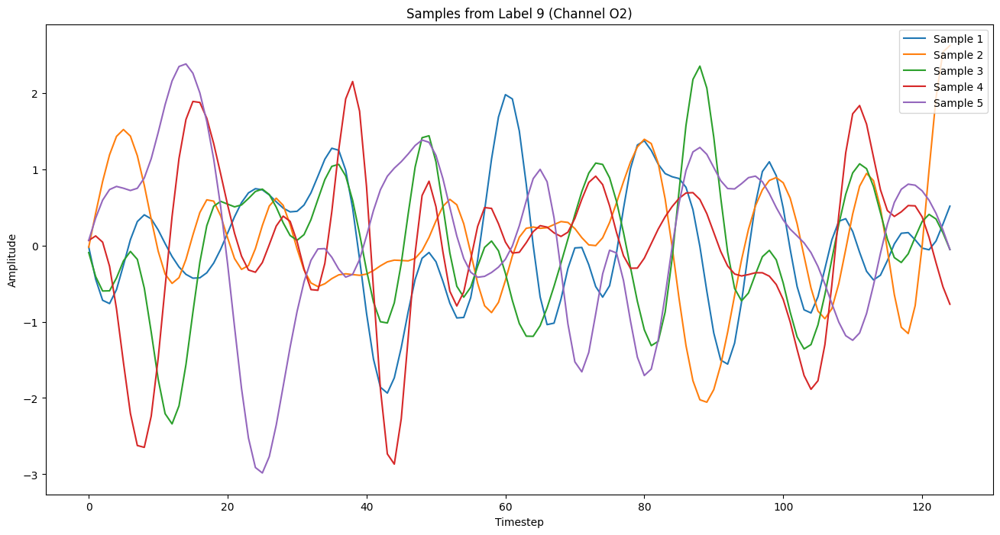

In [50]:
# SAMPLES
show_sample_per_label_per_channel(18, channels_32[18], X_upsampled, y_upsampled, 5)

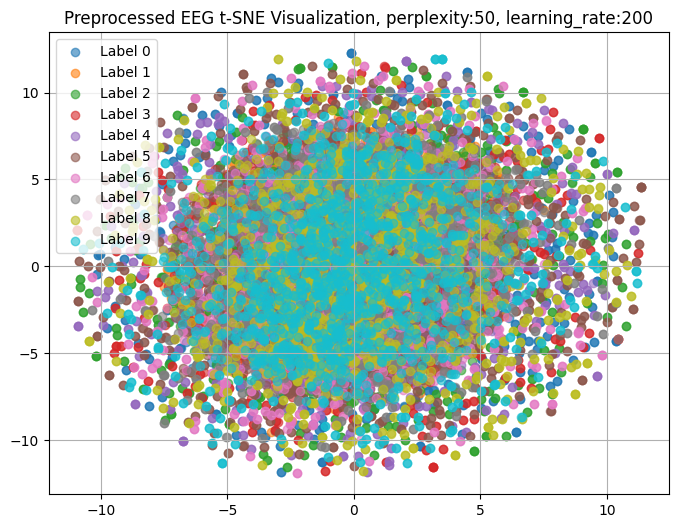

Final KL-Divergence: 4.425358772277832


In [55]:
# t-SNE
perplexities = [50]
learning_rates = [200]

for p in perplexities:
    for lr in learning_rates:
        visualize_tSNE(p, lr, X_upsampled, y_upsampled, "Preprocessed EEG t-SNE Visualization", '', '')

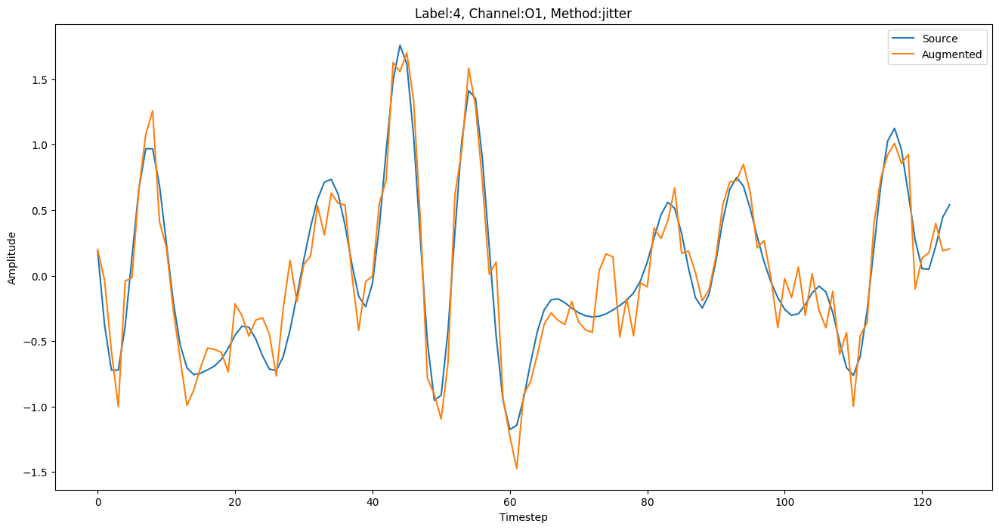

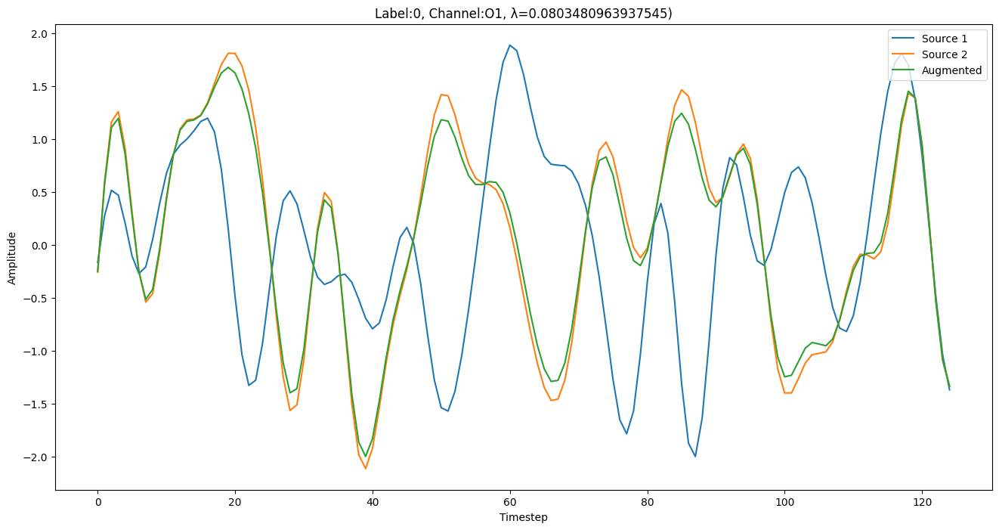

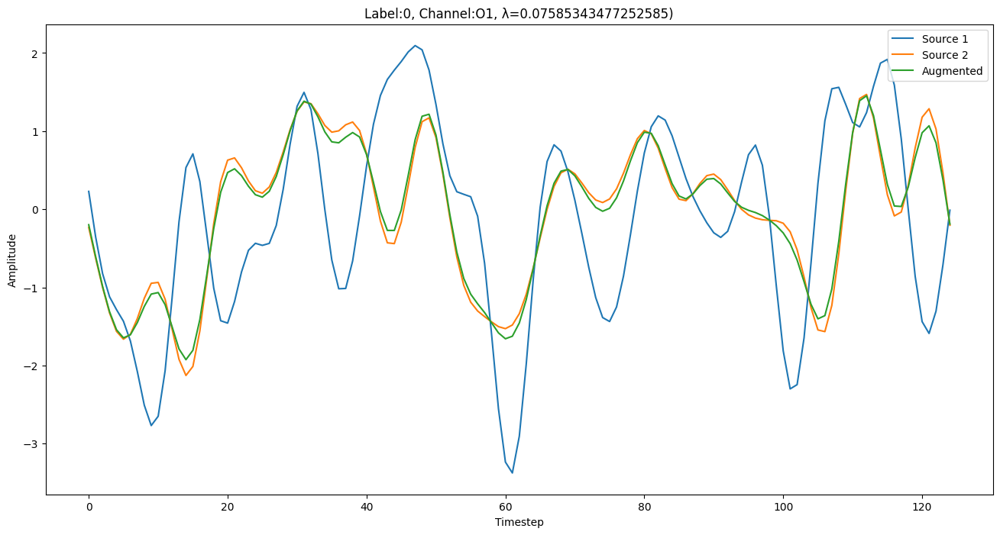

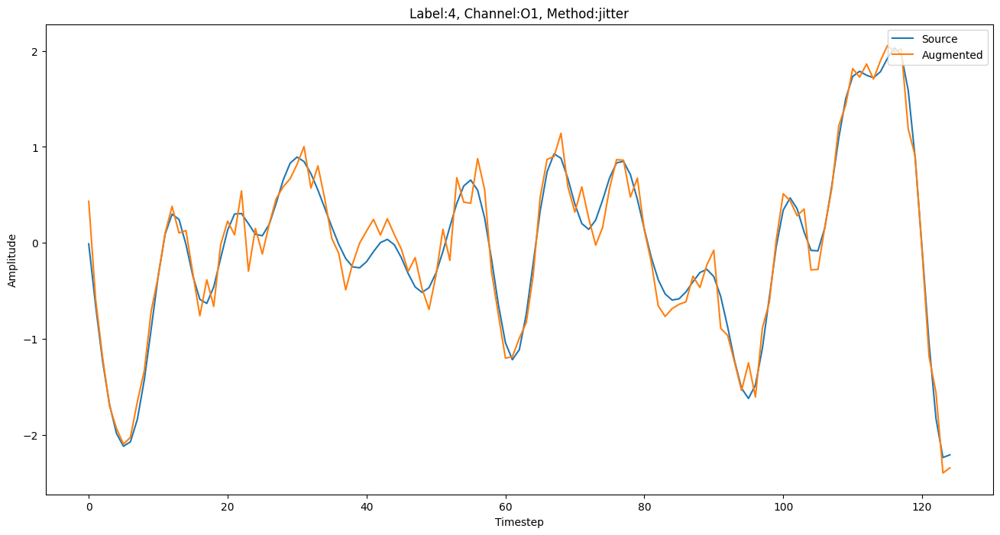

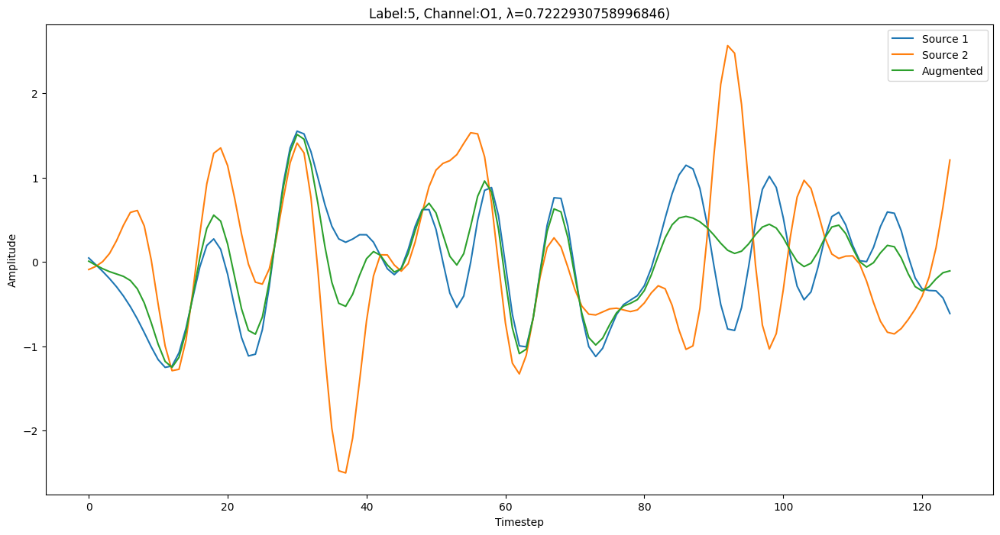

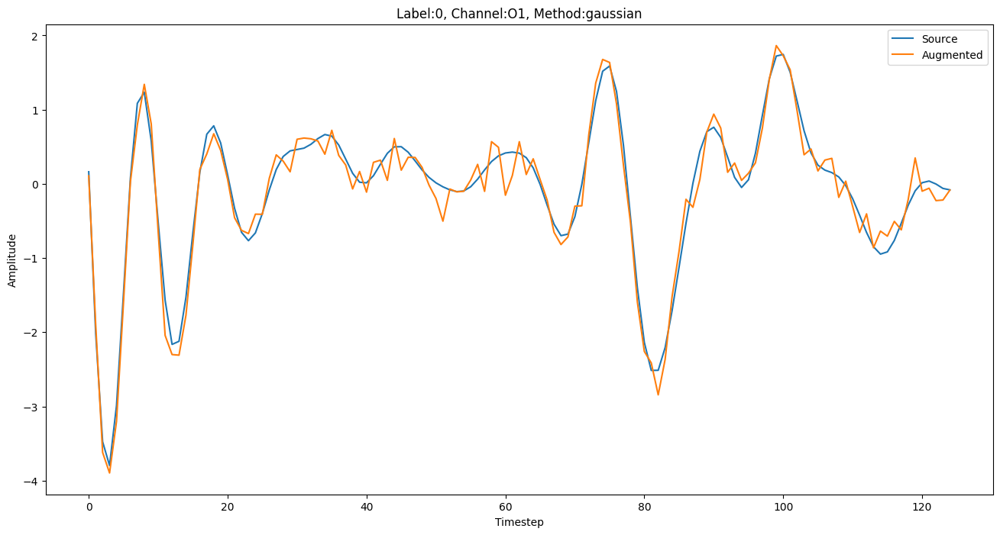

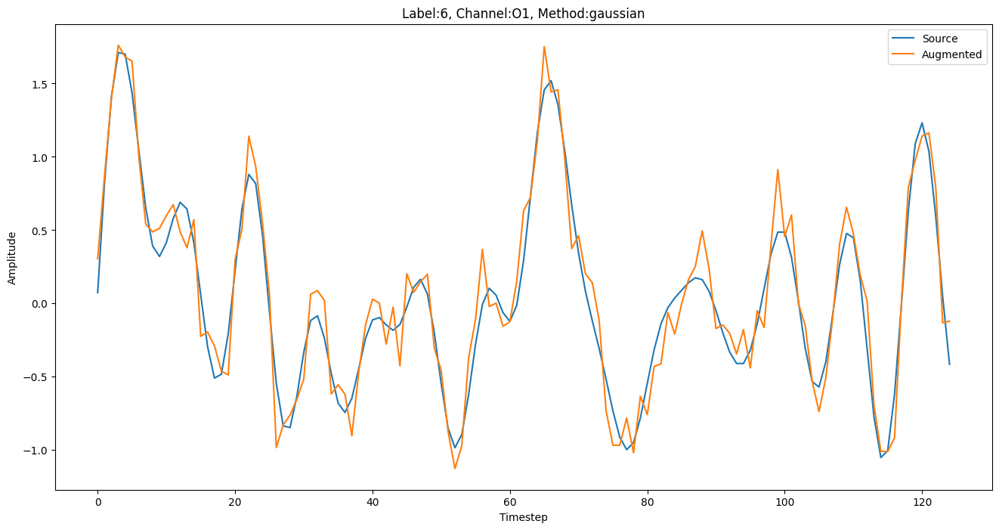

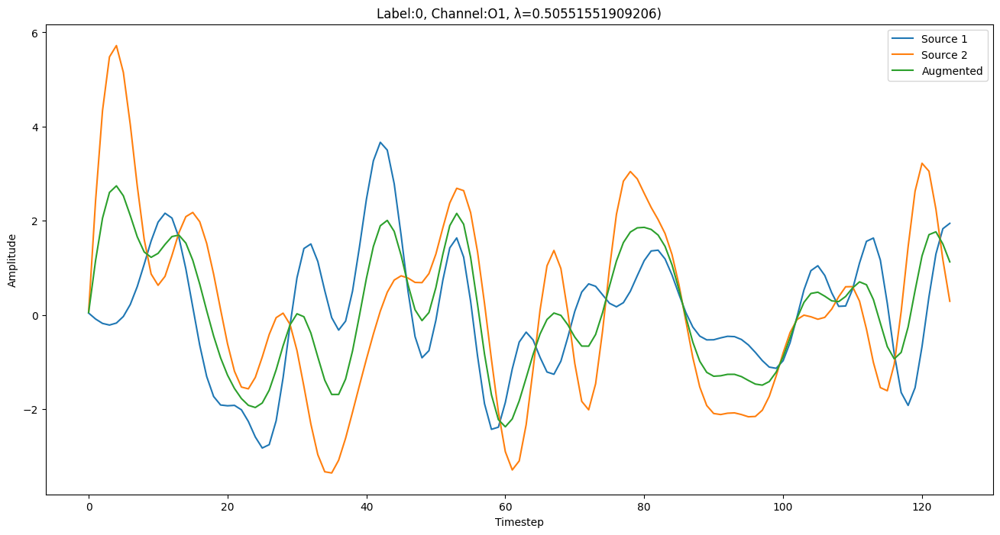

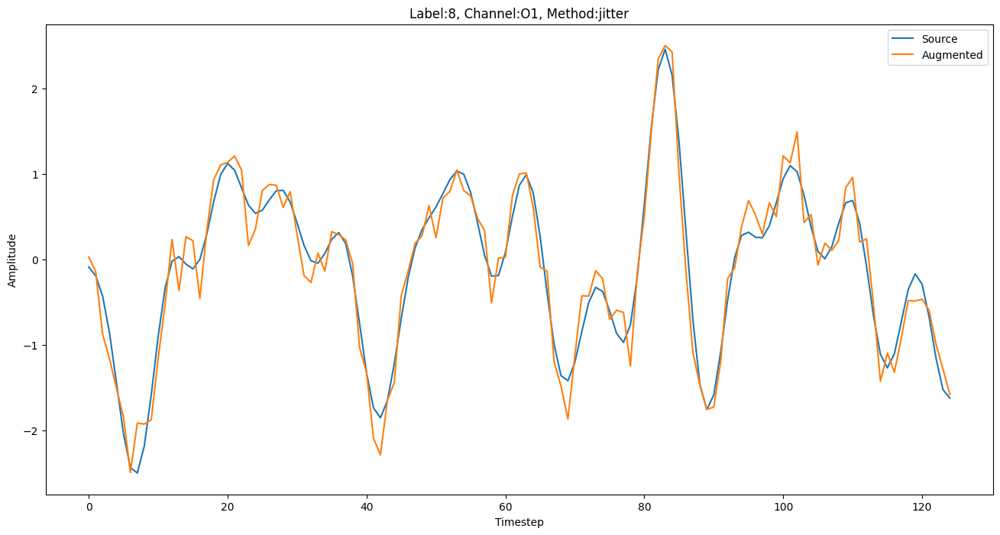

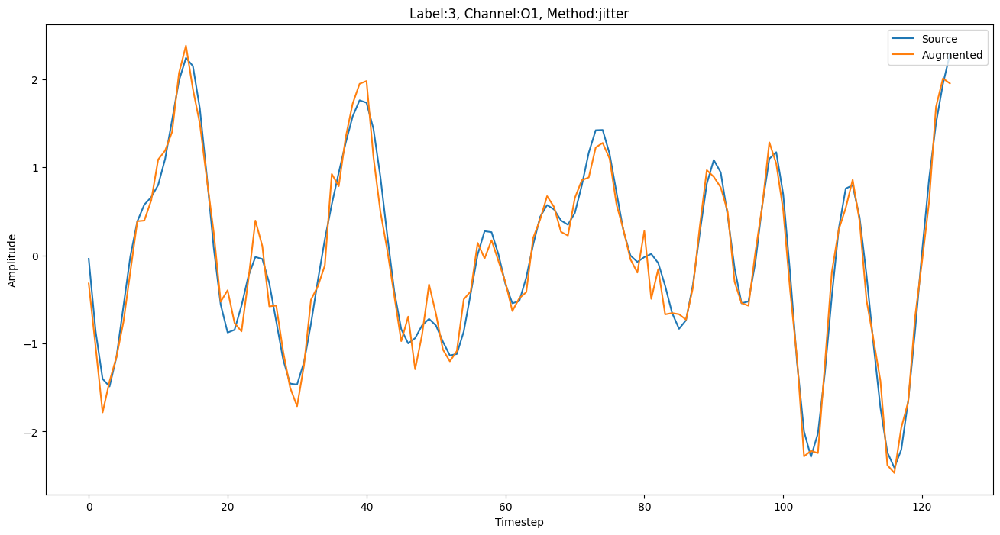

In [52]:
# Visualize Augmented Samples
import matplotlib.pyplot as plt

for i in range(10):
    plt.figure(figsize=(16, 8))
    if isinstance(dup_sources[i], tuple):
        (src1, src2), lam = dup_sources[i]
        plt.plot(X_upsampled[src1][13], label=f"Source 1")
        plt.plot(X_upsampled[src2][13], label=f"Source 2")
        plt.title(f"Label:{y_upsampled[src1]}, Channel:{channels_32[13]}, λ={lam})")
    else:
        plt.plot(X_upsampled[dup_sources[i]][13], label=f"Source")
        plt.title(f"Label:{y_upsampled[dup_sources[i]]}, Channel:{channels_32[13]}, Method:{aug_methods[i]}")
    
    plt.plot(X_upsampled[13716 + i][13], label=f"Augmented")
    plt.xlabel("Timestep")
    plt.ylabel("Amplitude")
    plt.legend(loc='upper right')
    plt.show()

### Save Preprocessed Data

In [56]:
import pickle

data_to_save = {
    'X': X_upsampled,
    'y': y_upsampled,
    'augmented_indices': aug_idx,
    'augmentation_methods': aug_methods,
    'duplication_sources': dup_sources
}

with open("processed_eeg_data.pkl", 'wb') as f:
    pickle.dump(data_to_save, f)

#### Retrive Processed

In [ ]:
import os
import pickle

path = '/kaggle/input/preprocessed-final-2/'
with open(os.path.join(path, "processed_eeg_data-2.pkl"), "rb") as f:
    processed = pickle.load(f)

print(processed.keys())
print(processed['X'].shape)
print(processed['y'].shape)

In [14]:
X_upsampled = processed['X']
y_upsampled = processed['y']

aug_idx = processed['augmented_indices']
aug_methods = processed['augmentation_methods']
dup_sources = processed['duplication_sources']